# КУРСОВОЙ ПРОЕКТ

# "ПРЕДСКАЗАНИЕ ЦЕН НА НЕДВИЖИМОСТЬ"
### Слушатель факультета ИИ: Рудаков А.А.
Дата: февраль 2021

**Цель проекта:** Предсказать цену на недвижимость (квартиры) в датасете test.csv.  

**Источник данных:** Два (2)  датасета с сайта соревнований Kaggle: [Real Estate Price Predict](https://www.kaggle.com/c/real-estate-price-prediction-moscow)
- train.csv (содержит признаки и цены на квартиры)
- test.csv (содержит только признаки).

## ОГЛАВЛЕНИЕ

#### [Путь к директориям и файлам](#path)
#### [Загрузка базовых библиотек](#lib)
#### [Оптимизация памяти](#memory)

#### [1. Анализ файла train.csv](#1)
* **[Описание датасета train.csv](#data_desc)**
* **[Основные статистики по каждому признаку](#main_init)**
    * **[Анализ целевой переменной PRICE](#target_analytics)**
    * **[Анализ степени зависимости целевой переменной от признаков](#target_feature_corr)**
    * **[Анализ признаков целевой переменной](#features_analytics)**
        * **[Количественные признаки](#num_features)**
        * **[Категориальные и бинарные признаки](#cat_bin_features)**
    * **[Заключение по анализу данных (до обработки)](#data_analysis_summary)**
   
#### [2. Анализ и обработа  данных исходного датасета EDA ](#EDA)
* **[Обработка исходного датасета без новых фичей и выбросов(df_prepeared_initial)](#initial_data_processing)**
* **[Разбиение исходного датасета](#train_split)**
* **[Подбор предварительной модели для исходного датасета](#intial_train_model)** 
  * **[Простая модель(Линейная регрессия)](#linear_initial)**
  * **[Простая модель(Линейная регрессия с L1-регуляризацией)](#L1_initial)**
  * **[Сложная модель (Регрессия КN-ближайших соседей)](#KN_Regressor)**
  * **[Сложная модель(Метод случайный лес -регрессия (RandomForestRegressor)](#initial_RandomForestRegressor)**
  * **[Сложная модель(Метод регрессии градиентного бустинга (GradientBoostingRegressor)](#GradientBoostingRegressor)**
  * **[Первые выводы по моделям  на исходных данных](#first_models_comments)**
* **[Подготовка данных для улучшенного обучения](#model_update)**
  * **[DataPipeline для исходного датасета](#DataPipeline_train)**
  * **[Обработанный исходный датасет с новыми фичами (df_prepeared_train)](#df_prepeared_train)** 
  
#### [3. Подбор модели предсказания целевой перемнной Price](#model_search)

* **[Предобработанный исходный датасет с новыми фичами](#df_prepeared_train)**
* **[Сохранение обработанного датасета df_prepeared_train](#df_prepeared_train_save)**
* **[Разбиение на текстовый и тренировочный сет](#split_prepeared)**
* **[Функция расчета точности предсказаний модели](#def_evaluate_predict)**
* **Подбор моделей**
  * **[Регрессионная модель дерева решений (DecissionTreeRegressor)](#prepeared_DecissionTreeRegressor)**
  * **[Регрессионная модель случайного дерева решений (RandomForestRegressor)](#prepeared_RandomForestRegressor)**
  * **[Регрессионная модель градиентного бустинга (GradientBoostingRegressor)](#prepeared_GradientBoostingRegressor)**
  * **[Сложная модель  стекинга  StackingRegressor](#stacking)**
  * **[Поиск гипперпараметров для выбранной модели GradientBosstingRegressor](#GridSearch_GradientBosstingRegressor)**

#### [4. Предсказание целевой перемнной Price на выбранной модели](#final_model)

**Путь к директориям и файлам**<a class='anchor' id='path'>

In [1]:
DATASET_PATH = './train.csv'
PREPARED_DATASET_PATH = './prepeared_train.csv'
TEST_DATASET_PATH = './test.csv'
REPORTS_FILE_PATH = './reports/'
SCALER_FILE_PATH = './models/scaler.pkl'
MODEL_FILE_PATH = './models/model.pkl'

**Загрузка базовых библиотек** <a class ='anchor' id = 'lib'> 

In [2]:
import numpy as np
import pandas as pd

import pickle # сохранение модели

from matplotlib import pyplot as plt
from pylab import rcParams as rc
import seaborn as sns
from IPython.display import Image #Для визуализации внешних картинок в ноутбуке

from scipy.stats import mode,skew
from statistics import variance, median

# Загрузка моделей (библиотек) для обучения sci-kit learn (sklearn)

from sklearn.model_selection import train_test_split, KFold, GridSearchCV # Разделение датасета
from sklearn.linear_model import LinearRegression, Lasso, Ridge

from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor, GradientBoostingRegressor
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.tree import DecisionTreeRegressor
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsRegressor



# Загрузка метрик оценки качества модели по условию курсового
from sklearn.metrics import mean_squared_error as mse, r2_score as r2

#Активация отображения графиков matlib/mathlab 

%matplotlib inline 

# Для четкости отображения графиков и текста

%config InlineBackend.figure_format = 'svg'

**Оптимизация памяти под данные** <a class ='anchor' id ='memory'>

In [3]:
def reduce_mem_usage(df):
    """ iterate through all the columns of a dataframe and modify the data type
        to reduce memory usage.        
    """
    start_mem = df.memory_usage().sum() / 1024**2
    print('Memory usage of dataframe is {:.2f} MB'.format(start_mem))
    
    for col in df.columns:
        col_type = df[col].dtype
        
        if col_type != object:
            c_min = df[col].min()
            c_max = df[col].max()
            if str(col_type)[:3] == 'int':
                if c_min > np.iinfo(np.int8).min and c_max < np.iinfo(np.int8).max:
                    df[col] = df[col].astype(np.int8)
                elif c_min > np.iinfo(np.int16).min and c_max < np.iinfo(np.int16).max:
                    df[col] = df[col].astype(np.int16)
                elif c_min > np.iinfo(np.int32).min and c_max < np.iinfo(np.int32).max:
                    df[col] = df[col].astype(np.int32)
                elif c_min > np.iinfo(np.int64).min and c_max < np.iinfo(np.int64).max:
                    df[col] = df[col].astype(np.int64)  
            else:
                if c_min > np.finfo(np.float32).min and c_max < np.finfo(np.float32).max:
                    df[col] = df[col].astype(np.float32)
                else:
                    df[col] = df[col].astype(np.float64)
        else:
            df[col] = df[col].astype('category')

    end_mem = df.memory_usage().sum() / 1024**2
    print('Memory usage after optimization is: {:.2f} MB'.format(end_mem))
    print('Decreased by {:.1f}%'.format(100 * (start_mem - end_mem) / start_mem))
    
    return df

### 1. Анализ файла train.csv<a class='anchor' id='1'>

**Описание датасета**<a class = 'anchor' id = 'data_desc'>
    
* **Id** - идентификационный номер квартиры
* **DistrictId** - идентификационный номер района
* **Rooms** - количество комнат
* **Square** - площадь
* **LifeSquare** - жилая площадь
* **KitchenSquare** - площадь кухни
* **Floor** - этаж
* **HouseFloor** - количество этажей в доме
* **HouseYear** - год постройки дома
* **Ecology_1, Ecology_2, Ecology_3** - экологические показатели местности
* **Social_1, Social_2, Social_3** - социальные показатели местности
* **Healthcare_1, Helthcare_2** - показатели местности, связанные с охраной здоровья
* **Shops_1, Shops_2** - показатели, связанные с наличием магазинов, торговых центров
* **Price** - цена квартиры

**Основные статистики по каждому признаку** <a class='anchor' id='main_init'>  
    
- Расчет основных статистик (минимальные, максимальные, средние значения и т.д) по признакам и по целевой переменной.
- Выводы об адекватности основных статистик.
- Подсчет для каждого признака, сколько в нем уникальных значений и как часто они встречаются.
- Выводы по каждому признаку.

In [4]:
df = pd.read_csv(DATASET_PATH, sep =',')
df_train = reduce_mem_usage(df)

Memory usage of dataframe is 1.53 MB
Memory usage after optimization is: 0.49 MB
Decreased by 68.1%


In [5]:
keys = df_train.keys()
keys_lst = [keys[i] for i in range(len(keys))]
print('Список названий колонок (ключи) train.csv :\n {}\n\nКоличество ключей(колонок): {}'.format(keys_lst, len(keys_lst)))

Список названий колонок (ключи) train.csv :
 ['Id', 'DistrictId', 'Rooms', 'Square', 'LifeSquare', 'KitchenSquare', 'Floor', 'HouseFloor', 'HouseYear', 'Ecology_1', 'Ecology_2', 'Ecology_3', 'Social_1', 'Social_2', 'Social_3', 'Healthcare_1', 'Helthcare_2', 'Shops_1', 'Shops_2', 'Price']

Количество ключей(колонок): 20


In [6]:
df_train.describe()

,Id,DistrictId,Rooms,Square,LifeSquare,KitchenSquare,Floor,HouseFloor,HouseYear,Ecology_1,Social_1,Social_2,Social_3,Healthcare_1,Helthcare_2,Shops_1,Price
count,10000.00000,10000.000000,10000.000000,10000.000000,7887.000000,10000.000000,10000.000000,10000.0000,1.000000e+04,10000.000000,10000.000000,10000.000000,10000.000000,5202.000000,10000.000000,10000.000000,10000.000000
mean,8383.40770,50.400800,1.890500,56.315720,37.199665,6.273300,8.526700,12.6094,3.990166e+03,0.118858,24.687000,5352.157400,8.039200,1142.904419,1.319500,4.231300,214138.937500
std,4859.01902,43.587592,0.839522,21.058716,86.241219,28.560839,5.241148,6.7762,2.005003e+05,0.119025,17.532614,4006.799803,23.831875,1021.519470,1.493601,4.806341,92872.273438
min,0.00000,0.000000,0.000000,1.136859,0.370619,0.000000,1.000000,0.0000,1.910000e+03,0.000000,0.000000,168.000000,0.000000,0.000000,0.000000,0.000000,59174.777344
25%,4169.50000,20.000000,1.000000,41.774879,22.769833,1.000000,4.000000,9.0000,1.974000e+03,0.017647,6.000000,1564.000000,0.000000,350.000000,0.000000,1.000000,153872.628906
50%,8394.50000,36.000000,2.000000,52.513309,32.781261,6.000000,7.000000,13.0000,1.977000e+03,0.075424,25.000000,5285.000000,2.000000,900.000000,1.000000,3.000000,192269.648438
75%,12592.50000,75.000000,2.000000,65.900627,45.128803,9.000000,12.000000,17.0000,2.001000e+03,0.195781,36.000000,7227.000000,5.000000,1548.000000,2.000000,6.000000,249135.460938
max,16798.00000,209.000000,19.000000,641.065186,7480.592285,2014.000000,42.000000,117.0000,2.005201e+07,0.521867,74.000000,19083.000000,141.000000,4849.000000,6.000000,23.000000,633233.437500


In [7]:
df_train[keys_lst].median()

Id                 8394.500000
DistrictId           36.000000
Rooms                 2.000000
Square               52.513309
LifeSquare           32.781261
KitchenSquare         6.000000
Floor                 7.000000
HouseFloor           13.000000
HouseYear          1977.000000
Ecology_1             0.075424
Social_1             25.000000
Social_2           5285.000000
Social_3              2.000000
Healthcare_1        900.000000
Helthcare_2           1.000000
Shops_1               3.000000
Price            192269.656250
dtype: float64

In [8]:
df_train[keys_lst].nunique()

Id               10000
DistrictId         205
Rooms                9
Square            9995
LifeSquare        7886
KitchenSquare       58
Floor               33
HouseFloor          44
HouseYear           97
Ecology_1          129
Ecology_2            2
Ecology_3            2
Social_1            51
Social_2           142
Social_3            30
Healthcare_1        79
Helthcare_2          7
Shops_1             16
Shops_2              2
Price             9996
dtype: int64

In [9]:
for i in range(len(keys_lst)):
    print('[{}] * {} '.format(df_train[keys_lst[i]].name, df_train[keys_lst[i]].mode()[0]))

[Id] * 0 
[DistrictId] * 27 
[Rooms] * 2.0 
[Square] * 37.49816131591797 
[LifeSquare] * 33.85965347290039 
[KitchenSquare] * 1.0 
[Floor] * 4 
[HouseFloor] * 17.0 
[HouseYear] * 1977 
[Ecology_1] * 0.007122316863387823 
[Ecology_2] * B 
[Ecology_3] * B 
[Social_1] * 2 
[Social_2] * 264 
[Social_3] * 0 
[Healthcare_1] * 540.0 
[Helthcare_2] * 0 
[Shops_1] * 0 
[Shops_2] * B 
[Price] * 182938.078125 


In [10]:
target = df['Price'] # Целевая переменная для которой нужен прогноз

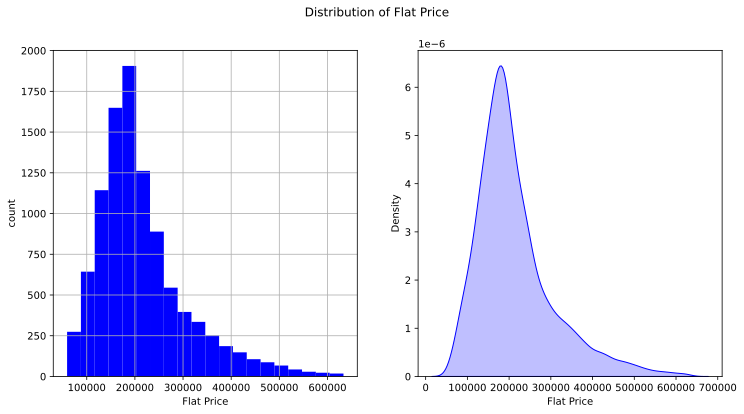

In [11]:
plt.figure(figsize = (12, 6))

plt.subplot(121)
target.hist(density=False,color = '#0000FF', bins=20)
plt.ylabel('count')
plt.xlabel('Flat Price')

plt.subplot(1,2,2)
sns.kdeplot(target, color = '#0000FF', shade=True, legend=False)
plt.xlabel('Flat Price')

plt.suptitle('Distribution of Flat Price')
plt.show()

In [12]:
print("Skewness: %f" % target.skew())
print("Kurtosis: %f" % target.kurt())
print("Variance: %f" % variance(target))
print("Mode: %f" % mode(target)[0])
print("Median: %f" % median(target))

Skewness: 1.366877
Kurtosis: 2.249410
Variance: 8625262983.915672
Mode: 182938.078125
Median: 192269.648438


Распределние целевой переменной отклоняется от нормального, положительно ассиметрично, выборка смещена влево:
- коэфциентом асссиметрии больше 0 (1.36667)
- эксцесс 2.24 (распределение отклонено от нормального)
- mode = 182 938.9156
- mediana = 192 269.648438
- variance = 8 62262 983 (достаточно высокая дисперсия, следует проверить данные)

In [13]:
target_mean =target.mean()
target_moda = mode(target)[0]
target_mediana = median(target)

In [14]:
print("Mean: %f" % target_mean)
print("Mode: %f" % target_moda)
print("Median: %f" % target_mediana)

Mean: 214138.937500
Mode: 182938.078125
Median: 192269.648438


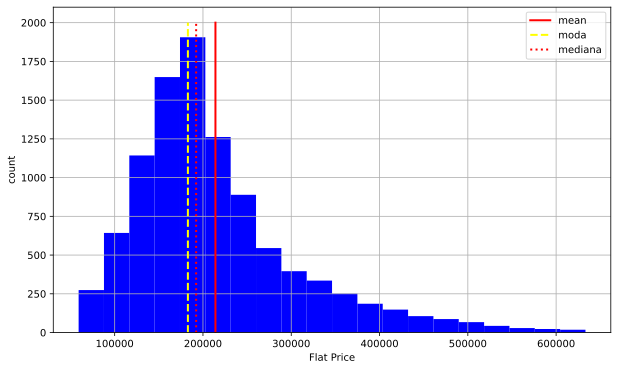

In [15]:
plt.figure(figsize = (10, 6))

y = np.linspace(0, 2000, 500) # Дял генерации вертикальной черты значений среднего,медианы и моды

target.hist(density = False, color = '#0000FF', bins=20)
plt.ylabel('count')
plt.xlabel('Flat Price')

plt.plot([target_mean]*500, y, color ='red', label='mean', linestyle='-', linewidth=2)
plt.plot([target_moda]*500, y, color ='yellow', label='moda', linestyle='--', linewidth=2)
plt.plot([target_mediana]*500, y, color ='red', label='mediana', linestyle=':', linewidth=2)

plt.legend()
plt.show()

In [16]:
print("50pr %f" % np.quantile(target, q=0.5))
print("25pr %f" % np.quantile(target, q=0.25))

50pr 192269.648438
25pr 153872.628906


In [17]:
np.quantile(target, q=0.25)

153872.62890625

Самая часто встречающаяся цена на квартиру в генеральной совокупности ниже среднего значения и приближается к медианному значению целефой переменной.

**Анализ степени зависимости целевой переменной от признаков** <a class ='anchor' id ='target_feature_corr'>

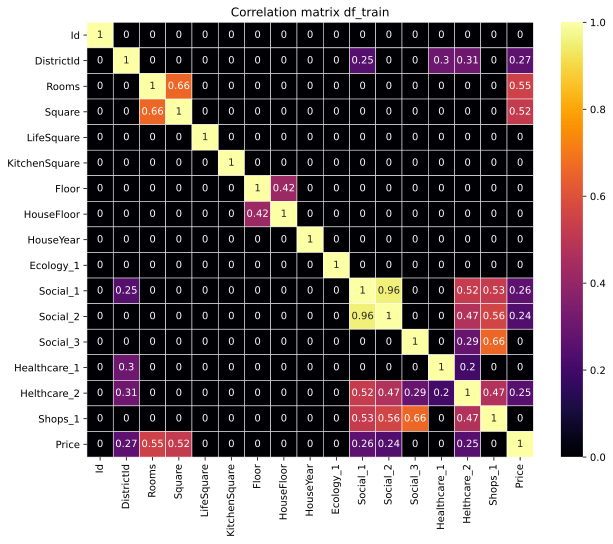

In [18]:
df_train_cor = df_train.corr()

plt.figure(figsize = (10,8))

np.round(df_train_cor, 2) # Округляем значение корреляции до 2 знаков после запятой

df_train_cor[np.abs(df_train_cor)<0.2] = 0 # Упрощаем отображение данных, по корреляции,оставив наиболеее полезные значения

sns.heatmap(df_train_cor, annot=True, linewidths=.5, cmap='inferno')

plt.title('Correlation matrix df_train')
plt.show()

In [19]:
df_train_cor['Price'] #Корреляции признаков с целевой переменной

Id               0.000000
DistrictId       0.265100
Rooms            0.550291
Square           0.520075
LifeSquare       0.000000
KitchenSquare    0.000000
Floor            0.000000
HouseFloor       0.000000
HouseYear        0.000000
Ecology_1        0.000000
Social_1         0.263286
Social_2         0.239226
Social_3         0.000000
Healthcare_1     0.000000
Helthcare_2      0.253090
Shops_1          0.000000
Price            1.000000
Name: Price, dtype: float64

Оценка корреляции целевой переменной Price показывает, что с ней наиболее тесно взаимосвязаны такие признаки, как:
- **Rooms** (кол-во комнат) ***0,55***
- **Square** (площадь квартиры) ***0.52***

Для рассмотрения степени связи целевой перемнной с исходными признаками, будем использовать так же те, чьи значения оказались ниже 50% (0.5), но при этом чуть выше чем установленная нами граница в 20%(0.2) :
- **Helthcare_2** (показатели местности по здравоохранению) ***0.25***
- **Social_1** (социальные показатели местности) ***0.26***
- **Social_2** (социальные показатели местности) ***0.24***

In [20]:
df_room = pd.concat([df_train['Price'],df_train['Rooms']], axis = 1)

plt.figure(figsize = (12, 6))
plt.subplot(121)

plt.scatter(df_room['Rooms'],df_room['Price'])

plt.xlabel('Rooms')
plt.ylabel('Flat Price')

plt.subplot(1,2,2)
plt.scatter(df_train['Square'],df_train['Price'])
plt.xlabel('Square')
plt.ylabel('Flat Price')

plt.show()

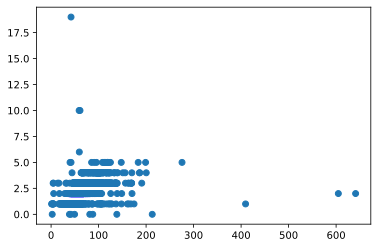

In [21]:
plt.scatter(df_train['Square'], df_train['Rooms'])


plt.show()

**Анализ признаков(features) целевой переменной** <a class ='anchor' id ='features_analytics'>

In [22]:
df_target_features_name = df_train.columns.drop(target.name) # имена исходных признаков (features name ) для целевой переменной

In [23]:
df_target_features = df_train.drop([target.name, 'Id'], axis = 1) # значения исходных признаков (features) для целевой переменной
df_target_features

,DistrictId,Rooms,Square,LifeSquare,KitchenSquare,Floor,HouseFloor,HouseYear,Ecology_1,Ecology_2,Ecology_3,Social_1,Social_2,Social_3,Healthcare_1,Helthcare_2,Shops_1,Shops_2
0,27,3.0,115.027313,NaN,10.0,4,10.0,2014,0.075424,B,B,11,3097,0,NaN,0,0,B
1,22,1.0,39.832523,23.169222,8.0,7,8.0,1966,0.118537,B,B,30,6207,1,1183.0,1,0,B
2,1,3.0,78.342216,47.671970,10.0,2,17.0,1988,0.025609,B,B,33,5261,0,240.0,3,1,B
3,1,1.0,40.409908,NaN,1.0,10,22.0,1977,0.007122,B,B,1,264,0,NaN,0,1,B
4,94,2.0,64.285065,38.562515,9.0,16,16.0,1972,0.282798,B,B,33,8667,2,NaN,0,6,B
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,61,2.0,49.090729,33.272625,6.0,3,12.0,1981,0.300323,B,B,52,10311,6,NaN,1,9,B
9996,27,2.0,64.307686,37.038422,9.0,13,0.0,1977,0.072158,B,B,2,629,1,NaN,0,0,A
9997,178,1.0,29.648056,16.555363,5.0,3,5.0,1958,0.460556,B,B,20,4386,14,NaN,1,5,B
9998,21,1.0,32.330292,22.326870,5.0,3,9.0,1969,0.194489,B,B,47,8004,3,125.0,3,5,B


In [24]:
df_target_features.isna().sum()

DistrictId          0
Rooms               0
Square              0
LifeSquare       2113
KitchenSquare       0
Floor               0
HouseFloor          0
HouseYear           0
Ecology_1           0
Ecology_2           0
Ecology_3           0
Social_1            0
Social_2            0
Social_3            0
Healthcare_1     4798
Helthcare_2         0
Shops_1             0
Shops_2             0
dtype: int64

В признаках ***LifeSquare*** и ***Healthcare_1*** пропущены значения в кол-ве 2112 и 4798  соответственно.     

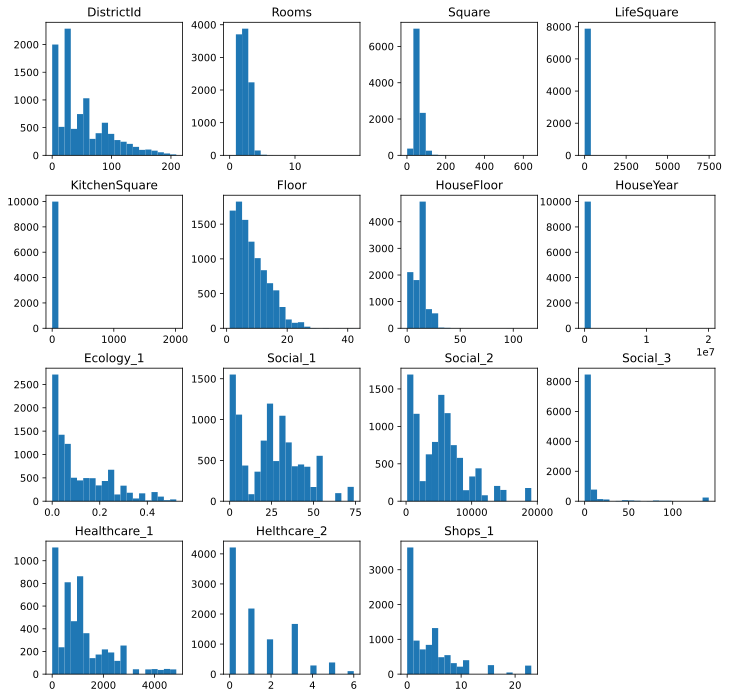

In [25]:
df_target_features.hist(figsize=(12,12), bins=20, grid=False)

plt.show()

<AxesSubplot:>

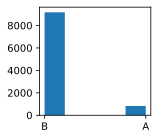

In [26]:
df_train['Shops_2'].hist(figsize=(2,2), bins=5, grid=False)

***Количественные признаки*** <a class ='anchor' id = 'num_features'>

In [27]:
df_target_features_num = df_train.select_dtypes(include=['float64', 'float32', 'float16']) # Кол-ные переменные
df_target_features_num.drop(target.name, axis = 1, inplace = True) 
df_target_features_num


C:\Users\aruda\anaconda3\lib\site-packages\pandas\core\frame.py:4163: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


,Rooms,Square,LifeSquare,KitchenSquare,HouseFloor,Ecology_1,Healthcare_1
0,3.0,115.027313,NaN,10.0,10.0,0.075424,NaN
1,1.0,39.832523,23.169222,8.0,8.0,0.118537,1183.0
2,3.0,78.342216,47.671970,10.0,17.0,0.025609,240.0
3,1.0,40.409908,NaN,1.0,22.0,0.007122,NaN
4,2.0,64.285065,38.562515,9.0,16.0,0.282798,NaN
...,...,...,...,...,...,...,...
9995,2.0,49.090729,33.272625,6.0,12.0,0.300323,NaN
9996,2.0,64.307686,37.038422,9.0,0.0,0.072158,NaN
9997,1.0,29.648056,16.555363,5.0,5.0,0.460556,NaN
9998,1.0,32.330292,22.326870,5.0,9.0,0.194489,125.0


In [28]:
print("Кол-во признаков целевой перемнной: %f" % len(df_target_features_name))
print("Кол-во КОЛИЧЕСТВЕННЫХ признаков целевой перемнной: %f" % len(df_target_features_num.columns))

Кол-во признаков целевой перемнной: 19.000000
Кол-во КОЛИЧЕСТВЕННЫХ признаков целевой перемнной: 7.000000


In [29]:
df_target_features_num.columns.tolist()

['Rooms',
 'Square',
 'LifeSquare',
 'KitchenSquare',
 'HouseFloor',
 'Ecology_1',
 'Healthcare_1']

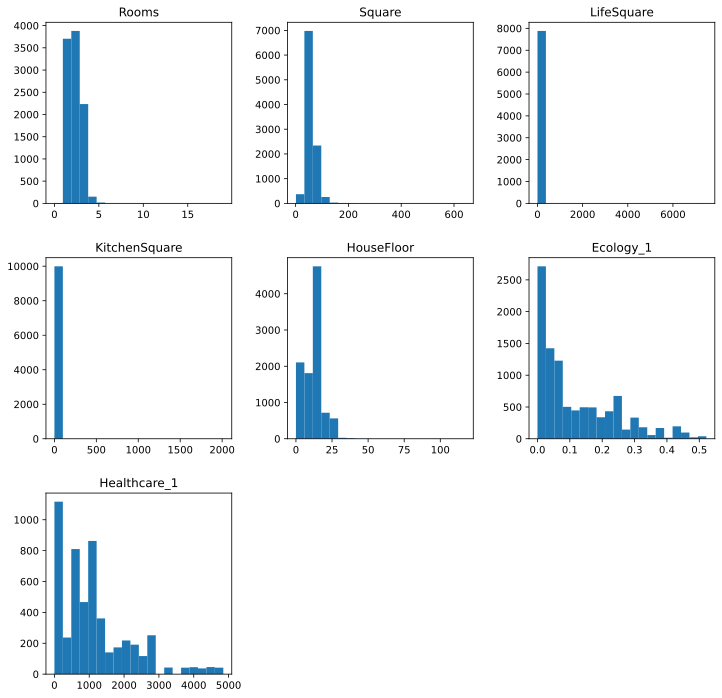

In [30]:
df_target_features_num.hist(figsize=(12,12), bins=20, grid=False)

plt.show()

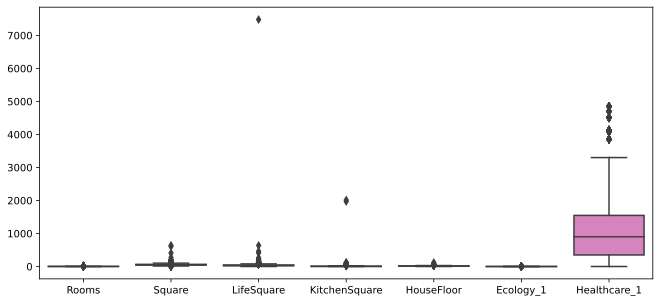

In [31]:
plt.figure(figsize=(11, 5))

sns.boxplot(data = df_target_features_num, whis=1.5)

plt.show()

Выбросы наблюдаются для признаков : ***Square, LifeSquare, KitchenSquare, Healthcare_1***

***Категориальные и бинарные признаки*** <a class ='anchor' id = 'cat_bin_features'>

In [32]:
df_target_features.drop(list(df_target_features_num.columns), axis =1 )
print(df_target_features.info())
df_target_features_cat = df_target_features.select_dtypes(include='category')
df_target_features_cat

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 18 columns):
 #   Column         Non-Null Count  Dtype   
---  ------         --------------  -----   
 0   DistrictId     10000 non-null  int16   
 1   Rooms          10000 non-null  float32 
 2   Square         10000 non-null  float32 
 3   LifeSquare     7887 non-null   float32 
 4   KitchenSquare  10000 non-null  float32 
 5   Floor          10000 non-null  int8    
 6   HouseFloor     10000 non-null  float32 
 7   HouseYear      10000 non-null  int32   
 8   Ecology_1      10000 non-null  float32 
 9   Ecology_2      10000 non-null  category
 10  Ecology_3      10000 non-null  category
 11  Social_1       10000 non-null  int8    
 12  Social_2       10000 non-null  int16   
 13  Social_3       10000 non-null  int16   
 14  Healthcare_1   5202 non-null   float32 
 15  Helthcare_2    10000 non-null  int8    
 16  Shops_1        10000 non-null  int8    
 17  Shops_2        10000 non-null  c

,Ecology_2,Ecology_3,Shops_2
0,B,B,B
1,B,B,B
2,B,B,B
3,B,B,B
4,B,B,B
...,...,...,...
9995,B,B,B
9996,B,B,A
9997,B,B,B
9998,B,B,B


In [33]:
df_target_features_cat['Ecology_2'].unique()

['B', 'A']
Categories (2, object): ['B', 'A']

In [34]:
df_target_features_cat['Ecology_3'].unique()

['B', 'A']
Categories (2, object): ['B', 'A']

In [35]:
df_target_features_cat['Shops_2'].unique()

['B', 'A']
Categories (2, object): ['B', 'A']

Категориальные признаки ***Ecology_2, Ecology_3, Shops_2*** можно привести к бинарным.

In [36]:
df_target_features_bin = df_train.select_dtypes(include=['int64','int32','int16', 'int8'])

In [37]:
df_target_features_bin

,Id,DistrictId,Floor,HouseYear,Social_1,Social_2,Social_3,Helthcare_2,Shops_1
0,11809,27,4,2014,11,3097,0,0,0
1,3013,22,7,1966,30,6207,1,1,0
2,8215,1,2,1988,33,5261,0,3,1
3,2352,1,10,1977,1,264,0,0,1
4,13866,94,16,1972,33,8667,2,0,6
...,...,...,...,...,...,...,...,...,...
9995,1260,61,3,1981,52,10311,6,1,9
9996,16265,27,13,1977,2,629,1,0,0
9997,2795,178,3,1958,20,4386,14,1,5
9998,14561,21,3,1969,47,8004,3,3,5


In [38]:
df_target_features_bin.columns.tolist()

['Id',
 'DistrictId',
 'Floor',
 'HouseYear',
 'Social_1',
 'Social_2',
 'Social_3',
 'Helthcare_2',
 'Shops_1']

In [39]:
df_target_features_bin.sort_values(by= ['DistrictId'],ascending=True)['DistrictId'].unique() # кол-во районов

array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
        13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
        26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
        39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
        52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
        65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
        78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
        91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
       104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
       117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129,
       130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142,
       143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155,
       156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168,
       169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 18

In [40]:
df_target_features_bin.sort_values(by= ['Social_3'],ascending=True)['Social_3'].unique() # колв-о категорий соц. состояния

array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  14,
        16,  19,  20,  23,  24,  27,  37,  39,  45,  48,  56,  59,  73,
        84,  87,  93, 141], dtype=int16)

In [41]:
df_target_features_bin.describe()

,Id,DistrictId,Floor,HouseYear,Social_1,Social_2,Social_3,Helthcare_2,Shops_1
count,10000.00000,10000.000000,10000.000000,1.000000e+04,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000
mean,8383.40770,50.400800,8.526700,3.990166e+03,24.687000,5352.157400,8.039200,1.319500,4.231300
std,4859.01902,43.587592,5.241148,2.005003e+05,17.532614,4006.799803,23.831875,1.493601,4.806341
min,0.00000,0.000000,1.000000,1.910000e+03,0.000000,168.000000,0.000000,0.000000,0.000000
25%,4169.50000,20.000000,4.000000,1.974000e+03,6.000000,1564.000000,0.000000,0.000000,1.000000
50%,8394.50000,36.000000,7.000000,1.977000e+03,25.000000,5285.000000,2.000000,1.000000,3.000000
75%,12592.50000,75.000000,12.000000,2.001000e+03,36.000000,7227.000000,5.000000,2.000000,6.000000
max,16798.00000,209.000000,42.000000,2.005201e+07,74.000000,19083.000000,141.000000,6.000000,23.000000


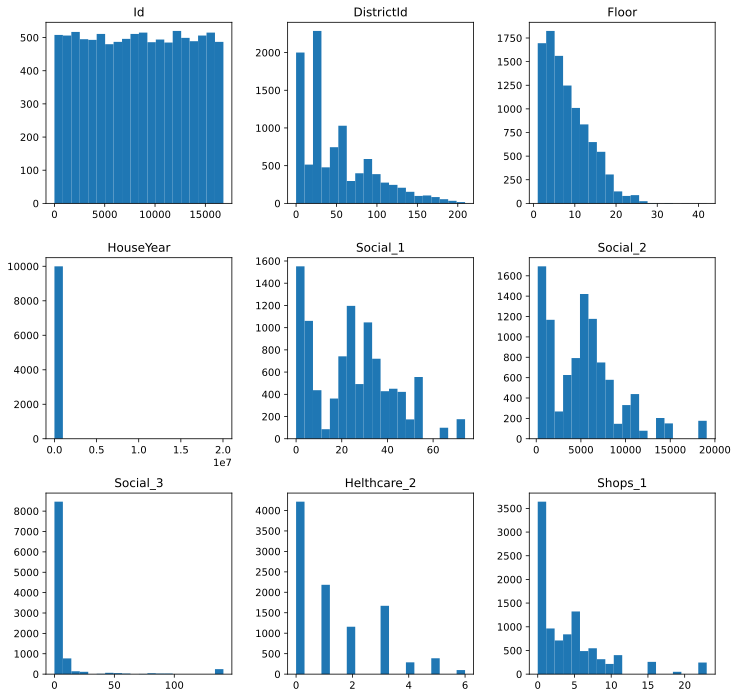

In [42]:
df_target_features_bin.hist(figsize=(12,12), bins=20, grid=False)

plt.show()

In [43]:
df_target_features_bin['Helthcare_2'].unique()

array([0, 1, 3, 2, 5, 4, 6], dtype=int8)

In [44]:
df_target_features_bin['Helthcare_2'].nunique()

7

In [45]:
df_target_features_bin['Helthcare_2'].value_counts()

0    4214
1    2183
3    1670
2    1158
5     388
4     288
6      99
Name: Helthcare_2, dtype: int64

Признак ***Helthcare_2*** отнесем к категориальным со шкалой от 0 до 6.

**Выводы об основных статистиках для признаков**:


* **Rooms** - минимальное значение 0 (некорректные наблюдения)
* **Square** - минимальная площадь квартиры 1м2 (некорректные наблюдения)
* **LifeSquare** - максимальное значение жилой площади завышено 7480 м2 (некорректные наблюдения)
* **KitchenSquare** - максимальное значение площади кухни завышено 2014 м2 (некорректные наблюдения)
* **HouseFloor** - максимальное значение этажа дома 117 (некорректные наблюдения)
* **HouseYear** - данные необходимо проверить и отформатировать

* **LifeSquare,HouseYear** - имеют пропущенные данные
* **LifeSquare (std=86), Social_2 (std=4006), Healthcare_1 (std=1021)** -наблюдается очень высокое отклонение значений от среднего по выборке, существуют выбросы.

In [46]:
print('Max HouseYear: {}'.format(df_train.sort_values(by= ['HouseYear'],ascending=True)['HouseYear'].max()))
print('Min HouseYear: {}'.format(df_train.sort_values(by= ['HouseYear'],ascending=True)['HouseYear'].min()))
print('Median: {}'.format(df_train.sort_values(by= ['HouseYear'],ascending=True)['HouseYear'].median()))
print('variance HouseYear: {}'.format(df_train.sort_values(by= ['HouseYear'],ascending=True)['HouseYear'].var()))

Max HouseYear: 20052011
Min HouseYear: 1910
Median: 1977.0
variance HouseYear: 40200354832.38829


Значения признака **HouseYear** заполнены не корректно,т.к. максимальное значение 200520211, что похоже на два года 2005 и 2011, при минимально знаечнии 1971.

In [47]:
df_train.sort_values(by= ['Rooms'],ascending=True)['Rooms'].unique()

array([ 0.,  1.,  2.,  3.,  4.,  5.,  6., 10., 19.], dtype=float32)

In [48]:
df_train.sort_values(by= ['HouseFloor'],ascending=True)['HouseFloor'].unique()

array([  0.,   1.,   2.,   3.,   4.,   5.,   6.,   7.,   8.,   9.,  10.,
        11.,  12.,  13.,  14.,  15.,  16.,  17.,  18.,  19.,  20.,  21.,
        22.,  23.,  24.,  25.,  26.,  27.,  28.,  29.,  30.,  31.,  32.,
        36.,  37.,  38.,  39.,  40.,  44.,  45.,  47.,  48.,  99., 117.],
      dtype=float32)

In [49]:
df_train.sort_values(by= ['Floor'],ascending=True)['Floor'].unique()

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 31, 32, 33, 37, 42],
      dtype=int8)

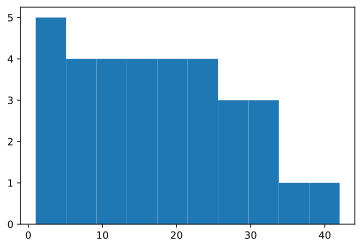

In [50]:
plt.hist(df_train.sort_values(by= ['Floor'],ascending=True)['Floor'].unique())
plt.show()

Дополнительные данные по уникальным значениям:
* Кол-во комнат имеет выброс равные 0 и 19,а так же под вопросом 10. Остальные значения 1-6 вполне логичные.
* Кол-во этажей дома так же имеет выбросы в виде значений равных 0, 99 и 117. Это доказывает и тот факт, что номер этажа квартиры находится в диапазоне от 1-42.

***Этажность дома и кол-во квартир можно использовать для генерации новых признаков позже.***

In [51]:
title_font = {
    'fontsize': 16,
    'fontweight': 10,
    'color': '#191970',
    'family':'Times New Roman'}

label_font = {
    'fontsize': 12,
    'fontweight': 8,
    'color': '#191970',
    'family':'Times New Roman'}

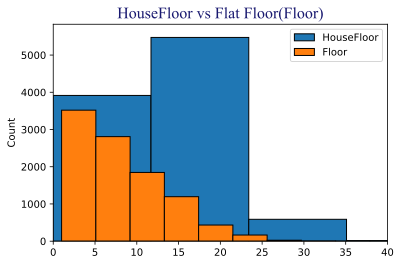

In [52]:
plt.figure(figsize=(6, 4))

plt.hist(df_train.sort_values(by= ['HouseFloor'],ascending=True)['HouseFloor'], label ='HouseFloor',ec ='black')
plt.ylabel('Count')
plt.title('HouseFloor vs Flat Floor(Floor)', fontdict = title_font)

plt.axis([0,40,0,df_train['HouseFloor'].value_counts().max()*2.5])

plt.hist(df_train.sort_values(by= ['Floor'],ascending=True)['Floor'], label ='Floor', ec ='black')

plt.legend()

(array([2514., 2765., 1775.,  696.,  976.,  520.,  360.,  204.,  139.,
          51.]),
 array([  0. ,  20.9,  41.8,  62.7,  83.6, 104.5, 125.4, 146.3, 167.2,
        188.1, 209. ]),
 <BarContainer object of 10 artists>)

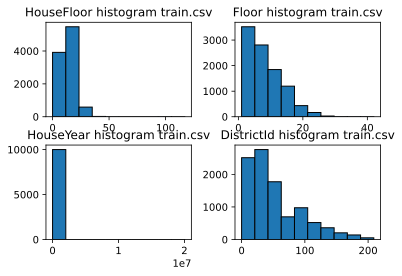

In [53]:
fig,ax = plt.subplots(nrows = 2, ncols = 2)

fig.subplots_adjust(hspace = 0.3, wspace = 0.3) # Вертикальные зазоры графика в дюймах
rc['figure.figsize'] = (8,6) #Установка размера фигуры 8' x 6'

ax1,ax2,ax3,ax4 = ax.flatten() # Преобразование в одномерный массив,чтобы не брать кортежи

x1 = df_train.sort_values(by= ['HouseFloor'],ascending=True)['HouseFloor']
x2 = df_train.sort_values(by= ['Floor'],ascending=True)['Floor']
x3 = df_train.sort_values(by= ['HouseYear'],ascending=True)['HouseYear']                       
x4 = df_train.sort_values(by= ['DistrictId'],ascending=True)['DistrictId'] 

y = df_train.sort_values(by= ['Price'],ascending=True)
                               
ax1.hist(x1,ec ='black')


ax1.set_title('HouseFloor histogram train.csv')
ax2.set_title('Floor histogram train.csv')
ax3.set_title('HouseYear histogram train.csv')
ax4.set_title('DistrictId histogram train.csv')

ax2.hist(x2,ec ='black')
ax3.hist(x3,ec ='black')
ax4.hist(x4,ec ='black')

In [54]:
print(df_train.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 20 columns):
 #   Column         Non-Null Count  Dtype   
---  ------         --------------  -----   
 0   Id             10000 non-null  int16   
 1   DistrictId     10000 non-null  int16   
 2   Rooms          10000 non-null  float32 
 3   Square         10000 non-null  float32 
 4   LifeSquare     7887 non-null   float32 
 5   KitchenSquare  10000 non-null  float32 
 6   Floor          10000 non-null  int8    
 7   HouseFloor     10000 non-null  float32 
 8   HouseYear      10000 non-null  int32   
 9   Ecology_1      10000 non-null  float32 
 10  Ecology_2      10000 non-null  category
 11  Ecology_3      10000 non-null  category
 12  Social_1       10000 non-null  int8    
 13  Social_2       10000 non-null  int16   
 14  Social_3       10000 non-null  int16   
 15  Healthcare_1   5202 non-null   float32 
 16  Helthcare_2    10000 non-null  int8    
 17  Shops_1        10000 non-null  i

In [55]:
df_target_features_num['KitchenSquare'].nunique()

58

In [56]:
df_target_features_num['KitchenSquare'].value_counts().head(10)

1.0     2460
8.0     1306
5.0     1169
10.0    1075
6.0     1038
9.0      843
0.0      697
7.0      609
12.0     249
11.0     233
Name: KitchenSquare, dtype: int64

In [57]:
df_target_features_num.sort_values(by= ['KitchenSquare'],ascending=True)['KitchenSquare'].max()

2014.0

In [58]:
df_target_features_num.sort_values(by= ['KitchenSquare'],ascending=True)['KitchenSquare'].describe()

count    10000.000000
mean         6.273300
std         28.560946
min          0.000000
25%          1.000000
50%          6.000000
75%          9.000000
max       2014.000000
Name: KitchenSquare, dtype: float64

In [59]:
df_target_features_num.sort_values(by= ['Square'],ascending=True)['Square'].describe()

count    10000.000000
mean        56.315681
std         21.058733
min          1.136859
25%         41.774879
50%         52.513309
75%         65.900627
max        641.065186
Name: Square, dtype: float64

In [60]:
df_target_features_bin.sort_values(by= ['Social_2'],ascending=True)['Social_2'].describe()

count    10000.000000
mean      5352.157400
std       4006.799803
min        168.000000
25%       1564.000000
50%       5285.000000
75%       7227.000000
max      19083.000000
Name: Social_2, dtype: float64

In [61]:
df_target_features_bin.sort_values(by= ['Social_2'],ascending=True)['Social_2'].mode()[0]

264

# Заключение по анализу данных (до обработки) <a class ='anchor' id = 'data_analysis_summary'>

***Количественные признаки:*** 
- Rooms (значение от 0 до 6,10 и 19) (минимальное значение 0 и,возможно, 19 - выбросы)
- Square (минимальная площадь квартиры 1 м2 - выбросы)
- LifeSquare (максимальное значение жилой площади завышено 7 480 м2 - выбросы)
- KitchenSquare (максимальное значение площади кухни завышено 2014 м2 - выбросы)
- HouseFloor (максимальное значение этажа дома 117, след. 99 - выбросы. Это доказывает и тот факт, что номер этажа квартиры находится в диапазоне от 1-42.)
- Ecology_1
- Healthcare_1

***Категориальные признаки:*** 
- Ecology_2 (значения A и B) - ***можно привести к бинарному***
- Ecology_3 (значения A и B) - ***можно привести к бинарному***
- Shops_2 (значения A и B)- ***можно привести к бинарному***

***Бинарные признаки:*** 
- DistrictId (кол-во уникальных номеров районов  - 205)
- Floor (значения от 1 до 42, без значения в 39)
- HouseYear (максимальное значение-200520211, что похоже на два года 2005 и 2021 или 2011, при минимальном значении 1971)  
- Social_1
- Social_2
- Social_3
- Helthcare_2 (можно теоретически отнести к категориальным со шкалой от 0 до 6).
- Shops_1

***Наиболее коррелирующие призаки с целевой переменной***
- **Rooms** (кол-во комнат) коэф-т корреляции ***0,55***
- **Square** (площадь квартиры) коэф-т корреляции ***0.52***
- **Helthcare_2** (показатели местности по здравоохранению 2)коэф-т корреляции ***0.25***
- **Social_1** (социальные показатели местности 1) коэф-т корреляции ***0.26***
- **Social_2** (социальные показатели местности 2)коэф-т корреляции ***0.24***


***Признаки с пустыми значениями(isna)*** - перед заполнением пустых значений **обработать выбросы!!**
- LifeSquare (2113 na)
- Helthcare_1 (4798 na)

***Признаки с наличием выборосов***
- Square (минимальная площадь квартиры 1 м2 - выбросы)* **(std=21.05)***
- Social_2 (moda = 264, mean = 5352, min =  168,  max =19083) ***(std=4006)***
- LifeSquare (имеет так же пустые значения na) ***(std=86)***
- KitchenSquare (мода = 1 м2, что является выбросом.) ***(std=86)***
- Healthcare_1( имеет так же пустые значения na) ***(std=1021)***


***Этажность дома и кол-во квартир можно использовать для генерации новых признаков позже.***


## Анализ и обработка данных (EDA) <a class='anchor' id='EDA'>

Используя выводы из анализа данных выше, в данном разделе будут решены следующие задачи:
* **Пропуски в исходных значениях** признаков в тренировочном датасете будут заполненны медианными значениями.
* **Строковые значения признаков** будут **переведены в бинарное значение** (числовое представление).    
* **Выбросы или неадекватные значения** в исходных значениях признаках,будут обработаны в соответствии логики.
* **Обработанный датасет** из train.csv  **будет разбит на обучающий и валидационный наборы данных**.

Для обработки дисходного датасета будет создан DataPiple для более удобной и быстрой обоработки исходных данных, а сам обработанный джатасет сохраним в файл pkl для повторного использования при выбоер оптимальной модели.


In [62]:
df_train.isna().sum() # Проверка на пропуски данных 0 - нет, 1 - есть, и подсчет кол-ва пропусков по признак

Id                  0
DistrictId          0
Rooms               0
Square              0
LifeSquare       2113
KitchenSquare       0
Floor               0
HouseFloor          0
HouseYear           0
Ecology_1           0
Ecology_2           0
Ecology_3           0
Social_1            0
Social_2            0
Social_3            0
Healthcare_1     4798
Helthcare_2         0
Shops_1             0
Shops_2             0
Price               0
dtype: int64

In [63]:
df_train['Square'].describe()

count    10000.000000
mean        56.315720
std         21.058716
min          1.136859
25%         41.774879
50%         52.513309
75%         65.900627
max        641.065186
Name: Square, dtype: float64

In [64]:
print(df_train['Square'].median())
print(mode(df_train['Square']))

52.513309478759766
ModeResult(mode=array([37.49816], dtype=float32), count=array([2]))


In [65]:
df_train['LifeSquare'].describe()

count    7887.000000
mean       37.199665
std        86.241219
min         0.370619
25%        22.769833
50%        32.781261
75%        45.128803
max      7480.592285
Name: LifeSquare, dtype: float64

In [66]:
print(df_train['LifeSquare'].median())
print(mode(df_train['LifeSquare']))

32.7812614440918
ModeResult(mode=array([33.859653], dtype=float32), count=array([2]))


In [67]:
df_train.sort_values(by = ['LifeSquare'],ascending=True)['LifeSquare']

3113    0.370619
1829    0.641822
119     0.795539
9869    0.873147
6882    1.049867
          ...   
9975         NaN
9978         NaN
9981         NaN
9983         NaN
9991         NaN
Name: LifeSquare, Length: 10000, dtype: float32

In [68]:
df_train['KitchenSquare'].describe()

count    10000.000000
mean         6.273300
std         28.560839
min          0.000000
25%          1.000000
50%          6.000000
75%          9.000000
max       2014.000000
Name: KitchenSquare, dtype: float64

In [69]:
df_train['KitchenSquare'].median()

6.0

In [70]:
df_train['Social_2'].median()

5285.0

In [71]:
df_train['Social_2'].describe()

count    10000.000000
mean      5352.157400
std       4006.799803
min        168.000000
25%       1564.000000
50%       5285.000000
75%       7227.000000
max      19083.000000
Name: Social_2, dtype: float64

In [72]:
df_train['Healthcare_1'].describe()

count    5202.000000
mean     1142.904419
std      1021.519470
min         0.000000
25%       350.000000
50%       900.000000
75%      1548.000000
max      4849.000000
Name: Healthcare_1, dtype: float64

In [73]:
df_train['Healthcare_1'].median()

900.0

In [74]:
df_train.loc[df_train['Rooms'] == 0]

,Id,DistrictId,Rooms,Square,LifeSquare,KitchenSquare,Floor,HouseFloor,HouseYear,Ecology_1,Ecology_2,Ecology_3,Social_1,Social_2,Social_3,Healthcare_1,Helthcare_2,Shops_1,Shops_2,Price
2194,3159,88,0.0,38.697117,19.345131,9.0,9,16.0,1982,0.127376,B,B,43,8429,3,NaN,3,9,B,158998.109375
3780,7317,27,0.0,41.790882,NaN,0.0,13,0.0,1977,0.211401,B,B,9,1892,0,NaN,0,1,B,98129.976562
5894,770,28,0.0,49.483501,NaN,0.0,16,0.0,2015,0.118537,B,B,30,6207,1,1183.0,1,0,B,217009.343750
6401,9443,27,0.0,87.762619,85.125473,0.0,5,15.0,1977,0.211401,B,B,9,1892,0,NaN,0,1,B,219281.921875
7644,7917,27,0.0,212.932358,211.231125,0.0,2,3.0,2008,0.211401,B,B,9,1892,0,NaN,0,1,B,302211.250000
7929,456,6,0.0,81.491447,NaN,0.0,4,0.0,1977,0.243205,B,B,5,1564,0,540.0,0,0,B,212864.796875
9767,12638,27,0.0,138.427689,136.215500,0.0,4,3.0,2016,0.075424,B,B,11,3097,0,NaN,0,0,B,268394.750000
9869,3224,27,0.0,2.377248,0.873147,0.0,1,0.0,1977,0.017647,B,B,2,469,0,NaN,0,0,B,126596.945312


In [75]:
df_train['Rooms'].median()

2.0

In [76]:
df_train['Rooms'].median()

2.0

In [77]:
df_train.loc[df_train['Square'] < df_train['LifeSquare']] 
# Не соотносится с логикой и физикой (жидлая площадь меньше чем общая,а не наоборот)

,Id,DistrictId,Rooms,Square,LifeSquare,KitchenSquare,Floor,HouseFloor,HouseYear,Ecology_1,Ecology_2,Ecology_3,Social_1,Social_2,Social_3,Healthcare_1,Helthcare_2,Shops_1,Shops_2,Price
33,847,74,2.0,73.314972,74.131264,1.0,7,6.0,1977,0.075779,B,B,6,1437,3,NaN,0,2,B,254005.375000
64,3992,1,3.0,87.200623,87.730225,0.0,21,22.0,1977,0.007122,B,B,1,264,0,NaN,0,1,B,300180.375000
77,11771,45,1.0,38.467278,39.624493,1.0,11,9.0,1977,0.195781,B,B,23,5212,6,NaN,3,2,B,247440.531250
100,13343,74,2.0,79.937668,82.931595,1.0,8,21.0,1977,0.075779,B,B,6,1437,3,NaN,0,2,B,226808.750000
111,13875,20,1.0,28.438793,32.514023,6.0,6,10.0,2014,0.019509,B,B,37,7687,11,176.0,5,5,B,199248.109375
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9960,16258,48,3.0,96.056786,98.152802,1.0,15,1.0,2017,0.041125,B,B,46,9515,5,NaN,1,10,B,524365.562500
9962,14175,14,1.0,42.029175,44.682167,10.0,4,4.0,2018,0.238617,B,B,26,3889,6,705.0,3,6,B,87556.382812
9979,2201,6,1.0,40.043236,41.984322,1.0,3,17.0,2014,0.243205,B,B,5,1564,0,540.0,0,0,B,134888.078125
9987,11665,1,2.0,62.690056,64.602936,10.0,19,22.0,2018,0.007122,B,B,1,264,0,NaN,0,1,B,203908.187500


In [78]:
df_train.loc[df_train['Square'] < df_train['KitchenSquare']] 

,Id,DistrictId,Rooms,Square,LifeSquare,KitchenSquare,Floor,HouseFloor,HouseYear,Ecology_1,Ecology_2,Ecology_3,Social_1,Social_2,Social_3,Healthcare_1,Helthcare_2,Shops_1,Shops_2,Price
2785,6569,27,1.0,38.220257,18.716856,84.0,4,17.0,2018,0.011654,B,B,4,915,0,NaN,0,0,B,99079.960938
5273,13703,42,1.0,38.071693,19.723547,73.0,9,10.0,2006,0.158249,B,B,21,5731,0,NaN,1,0,B,160488.031250
6505,14679,81,1.0,32.276665,19.278395,1970.0,6,1.0,1977,0.006076,B,B,30,5285,0,645.0,6,6,B,105539.554688
9520,14656,62,1.0,47.100719,46.447960,2014.0,4,1.0,2014,0.072158,B,B,2,629,1,NaN,0,0,A,108337.484375


In [79]:
df_train.loc[df_train['HouseYear']>2019, 'HouseYear'] # Проверяем выбросы в годе строительства дома

1004        2020
1077        2020
1976        2020
2350        2020
3171        2020
3196        2020
5412        2020
5641        2020
6073        2020
7207        2020
7246        2020
7302        2020
7721        2020
7955        2020
8296        2020
8664        2020
8828        4968
9091        2020
9122        2020
9163    20052011
9400        2020
Name: HouseYear, dtype: int32

*Исходный датасет без обработки выбросов и новых фичей (df_train1):*

In [80]:
df_train1 = df_train.copy() # Создадим копию исходного датасета для использования при подборе моделей

**Обработка исходного датасета без новых фичей и выбросов** <a class = 'anchor' id = 'initial_data_processing'>

In [81]:
# Заполняем пропуски медианными значениями

median_ls = df_train1['LifeSquare'].median()
median_hc1 = df_train1['Healthcare_1'].median()

df_train1['LifeSquare'] = df_train1['LifeSquare'].fillna(median_ls)
df_train1['Healthcare_1'] = df_train1['Healthcare_1'].fillna(median_hc1)

df_train1.isna().sum()

Id               0
DistrictId       0
Rooms            0
Square           0
LifeSquare       0
KitchenSquare    0
Floor            0
HouseFloor       0
HouseYear        0
Ecology_1        0
Ecology_2        0
Ecology_3        0
Social_1         0
Social_2         0
Social_3         0
Healthcare_1     0
Helthcare_2      0
Shops_1          0
Shops_2          0
Price            0
dtype: int64

In [82]:
# Замена строковых A и B на числовые данные A = 1,  B = 0

df_train1['Ecology_2'] = (df_train1['Ecology_2'] =='B').astype(int)
df_train1['Ecology_3'] = (df_train1['Ecology_2'] =='B').astype(int)
df_train1['Shops_2'] = (df_train1['Ecology_2'] =='B').astype(int)

df_train1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 20 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             10000 non-null  int16  
 1   DistrictId     10000 non-null  int16  
 2   Rooms          10000 non-null  float32
 3   Square         10000 non-null  float32
 4   LifeSquare     10000 non-null  float32
 5   KitchenSquare  10000 non-null  float32
 6   Floor          10000 non-null  int8   
 7   HouseFloor     10000 non-null  float32
 8   HouseYear      10000 non-null  int32  
 9   Ecology_1      10000 non-null  float32
 10  Ecology_2      10000 non-null  int32  
 11  Ecology_3      10000 non-null  int32  
 12  Social_1       10000 non-null  int8   
 13  Social_2       10000 non-null  int16  
 14  Social_3       10000 non-null  int16  
 15  Healthcare_1   10000 non-null  float32
 16  Helthcare_2    10000 non-null  int8   
 17  Shops_1        10000 non-null  int8   
 18  Shops_2

**Сохранение подготовленного дата сета** используя обработку данных в ввиде ***заполнение пропусков в признаках медианным значениями*** и использования разбиение строковых значений ***на бинарные признаки SHOPS_2, ECOLOGY_2,ECOLOGY_3***

In [83]:
df_train1.to_csv('df_prepeared_initial.csv', sep = ',', index=False, encoding='utf-8') 
# Имя csv файла для загрузки df_prepeared_initial.csv

**Разбиение датасета** <a class ='anchor' id ='train_split'>
Создание обучающего и валидационного дата сетов из копии датасет train с отредактированными данными

In [84]:
df_prepeared = pd.read_csv('df_prepeared_initial.csv', sep =',')
df_prepeared = reduce_mem_usage(df_prepeared)

Memory usage of dataframe is 1.53 MB
Memory usage after optimization is: 0.49 MB
Decreased by 68.1%


In [85]:
X = df_prepeared.drop(['Price'], axis =1)
Y = df_prepeared['Price']
X_train, X_valid, y_train, y_valid = train_test_split(X, Y, test_size=0.5, random_state=42)

In [86]:
print('X_train shape: {}\nX_train size: {}'.format(X_train.shape,X_train.size))
print('X_valid shape: {}\nX_train size: {}'.format(X_train.shape,X_valid.size))
print('y_train shape: {}\nX_train size: {}'.format(X_train.shape,y_train.size))
print('y_valid shape: {}\nX_train size: {}'.format(X_train.shape,y_valid.size))

X_train shape: (5000, 19)
X_train size: 95000
X_valid shape: (5000, 19)
X_train size: 95000
y_train shape: (5000, 19)
X_train size: 5000
y_valid shape: (5000, 19)
X_train size: 5000


In [87]:
X_train.describe()

,Id,DistrictId,Rooms,Square,LifeSquare,KitchenSquare,Floor,HouseFloor,HouseYear,Ecology_1,Ecology_2,Ecology_3,Social_1,Social_2,Social_3,Healthcare_1,Helthcare_2,Shops_1,Shops_2
count,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5.000000e+03,5000.000000,5000.000000,5000.0,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.0
mean,8342.675200,50.172400,1.893200,56.389702,35.286102,6.221600,8.485200,12.533600,5.995540e+03,0.117473,0.989400,0.0,24.436800,5303.014200,7.839200,1015.544189,1.302400,4.151200,0.0
std,4891.461288,43.725899,0.810152,22.840694,18.854881,28.232946,5.202422,6.728992,2.835502e+05,0.118304,0.102419,0.0,17.601238,4030.196974,23.566952,748.033142,1.479795,4.755593,0.0
min,11.000000,0.000000,0.000000,1.136859,0.641822,0.000000,1.000000,0.000000,1.912000e+03,0.000000,0.000000,0.0,0.000000,168.000000,0.000000,0.000000,0.000000,0.000000,0.0
25%,4089.250000,18.750000,1.000000,41.750885,25.245647,1.000000,4.000000,9.000000,1.974000e+03,0.017647,1.000000,0.0,6.000000,1564.000000,0.000000,810.000000,0.000000,1.000000,0.0
50%,8351.000000,34.000000,2.000000,52.731188,32.781261,6.000000,7.000000,12.000000,1.977000e+03,0.072158,1.000000,0.0,25.000000,5261.000000,2.000000,900.000000,1.000000,3.000000,0.0
75%,12537.250000,75.000000,2.000000,65.813046,41.067337,9.000000,12.000000,17.000000,2.001250e+03,0.194812,1.000000,0.0,35.000000,7227.000000,4.000000,900.000000,2.000000,5.000000,0.0
max,16798.000000,208.000000,5.000000,641.065186,638.163208,1970.000000,42.000000,117.000000,2.005201e+07,0.521867,1.000000,0.0,74.000000,19083.000000,141.000000,4849.000000,6.000000,23.000000,0.0


In [88]:
X_valid.describe()

,Id,DistrictId,Rooms,Square,LifeSquare,KitchenSquare,Floor,HouseFloor,HouseYear,Ecology_1,Ecology_2,Ecology_3,Social_1,Social_2,Social_3,Healthcare_1,Helthcare_2,Shops_1,Shops_2
count,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.0,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.0
mean,8424.140200,50.629200,1.887800,56.241913,37.245949,6.325000,8.568200,12.685200,1984.792600,0.120242,0.991200,0.0,24.937200,5401.300600,8.239200,1037.173584,1.336600,4.311400,0.0
std,4826.504134,43.452016,0.867968,19.113363,106.686119,28.887911,5.279784,6.822496,18.455766,0.119737,0.093404,0.0,17.461897,3983.061903,24.094582,745.210876,1.507234,4.855713,0.0
min,0.000000,0.000000,0.000000,2.377248,0.370619,0.000000,1.000000,0.000000,1910.000000,0.000000,0.000000,0.0,0.000000,168.000000,0.000000,30.000000,0.000000,0.000000,0.0
25%,4242.750000,21.000000,1.000000,41.790122,25.911564,1.000000,4.000000,9.000000,1974.000000,0.019509,1.000000,0.0,6.000000,1564.000000,0.000000,830.000000,0.000000,1.000000,0.0
50%,8442.500000,37.000000,2.000000,52.280092,32.781261,6.000000,7.000000,14.000000,1977.000000,0.075779,1.000000,0.0,25.000000,5285.000000,2.000000,900.000000,1.000000,3.000000,0.0
75%,12638.750000,75.000000,2.000000,66.015882,41.867399,9.000000,12.000000,17.000000,2001.000000,0.195781,1.000000,0.0,36.000000,7287.000000,5.000000,1020.000000,3.000000,6.000000,0.0
max,16797.000000,209.000000,19.000000,212.932358,7480.592285,2014.000000,37.000000,99.000000,2020.000000,0.521867,1.000000,0.0,74.000000,19083.000000,141.000000,4849.000000,6.000000,23.000000,0.0


In [89]:
y_train.describe()

count      5000.000000
mean     212962.921875
std       91634.906250
min       59174.777344
25%      153266.367188
50%      191638.632812
75%      247276.937500
max      627525.062500
Name: Price, dtype: float64

In [90]:
y_valid.describe()

count      5000.000000
mean     215314.296875
std       94087.906250
min       60825.031250
25%      154562.382812
50%      193024.132812
75%      250442.902344
max      633233.437500
Name: Price, dtype: float64

Требуется стандартизация признаков, из-за разности в значениях mean, std, что говорит о невозможности их сравнить по влиянию на целевую перемнную после прогноза и обучения на модели. Но для наглядности проведем обучение на не стандартизированных признаках и сравним результат.

#### Подбор предварительной модели для исходного датасета.  <a class ='anchor' id ='intial_train_model'>

В данном разделе произведены подборки простых и сложных моделей для исходного тренировочного датасета до генерации новых признаков, изменения данных для обучения в датасете и оббработкой пропусков не модами,а иными значениями.
Будут просчитаны ошибки R2 и сделаны выводы для простой и сложной моделей.

**Простая модель(Линейная регрессия)** <a class ='anchor' id ='linear_initial'>

 Сначала используем не стандартизированные значения признаков:

In [91]:
lr_model = LinearRegression()
lr_model.fit(X_train, y_train)

y_pred = lr_model.predict(X_valid)

In [92]:
check_valid = pd.DataFrame({
     'y_valid': y_valid,
    'y_pred': y_pred
})

check_valid.head()

,y_valid,y_pred
6252,225202.093750,288218.691426
4684,361744.281250,203156.268637
1731,275055.187500,263449.270172
4742,198133.703125,177724.779443
4521,221299.453125,151161.838471


In [93]:
R2 = r2(check_valid['y_valid'], check_valid['y_pred'])
MSE =  mse(y_valid,y_pred)

In [94]:
print('R2 : {}\nMSE : {}'.format(R2,MSE))

R2 : 0.46371865269763257
MSE : 4746499221.111505


In [95]:
w0 = lr_model.intercept_ # w0

In [96]:
coef = lr_model.coef_

In [97]:
plt.rcParams['figure.figsize'] = (6, 4)

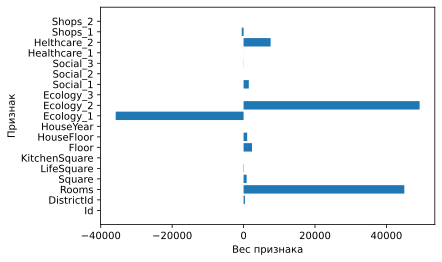

In [98]:
feature_names = X.columns

plt.barh(feature_names, lr_model.coef_.flatten())

plt.xlabel("Вес признака")
plt.ylabel("Признак")

plt.show()

**Стандартизация признаков:**

In [99]:
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_train_scaled = pd.DataFrame(X_train_scaled, columns=feature_names)

X_valid_scaled = scaler.transform(X_valid)
X_valid_scaled = pd.DataFrame(X_valid_scaled, columns=feature_names)

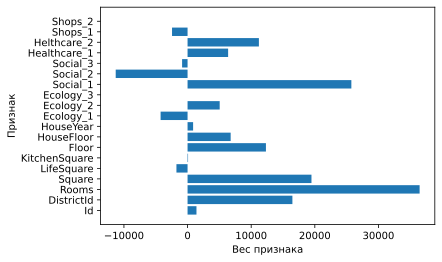

In [100]:
#Обучение  на стандартизованных признаках

lr_model.fit(X_train_scaled, y_train)


plt.barh(feature_names, lr_model.coef_.flatten())

plt.xlabel("Вес признака")
plt.ylabel("Признак")

plt.show()

In [101]:
# Прогноз на стандартизированных признаках

lr_model.fit(X_train_scaled, y_train)
y_pred_st = lr_model.predict(X_valid_scaled)

In [102]:
R2_st = r2(y_valid, y_pred_st)
MSE_st =  mse(y_valid,y_pred_st)

In [103]:
RMSE = np.sqrt(MSE)
RMSE_st = np.sqrt(MSE_st)

In [104]:
print('R2 vs R2_st : {} vs {}'.format (R2.round(4),R2_st.round(4)))
print('MSE vs MSE_st : {} vs {}'.format (MSE.round(4),MSE_st.round(4)))
print('RMSE vs RMSE_st : {} vs {}'.format (RMSE.round(4),RMSE_st.round(4)))

R2 vs R2_st : 0.4637 vs 0.4637
MSE vs MSE_st : 4746499221.1115 vs 4746499221.1113
RMSE vs RMSE_st : 68894.8418 vs 68894.8418


In [105]:
w0_st = lr_model.intercept_ # w0
coef_st =lr_model.coef_

In [106]:
print('w0 vs w0_st : {} vs {}'.format (w0,w0_st))
print('coef\n{}'.format(coef))
print('coef_st\n{}'.format(coef_st))

w0 vs w0_st : -52693.93305249713 vs 212962.98771953126
coef
[ 2.86255850e-01  3.76858740e+02  4.50226874e+04  8.52693748e+02
 -9.27284727e+01  2.77318731e+00  2.36794482e+03  1.00667831e+03
  3.07484065e-03 -3.58140971e+04  4.93039660e+04  1.81898940e-11
  1.46274780e+03 -2.80228425e+00 -3.64041134e+01  8.52375632e+00
  7.57710640e+03 -5.13193296e+02  0.00000000e+00]
coef_st
[ 1.40006938e+03  1.64768394e+04  3.64709824e+04  1.94741787e+04
 -1.74821603e+03  7.82873917e+01  1.23178161e+04  6.77326735e+03
  8.71784437e+02 -4.23654180e+03  5.04917869e+03  6.36646291e-12
  2.57435968e+04 -1.12926281e+04 -8.57848193e+02  6.37546631e+03
  1.12114402e+04 -2.44029421e+03  0.00000000e+00]


In [107]:
max(np.abs(coef_st)) # Слишком выоские веса -признак переобучения

36470.982449570045

**Простая модель(линейная регрессия с L1-регуляризацией)** <a class ='anchor' id ='L1_initial'>

В качестве сложной модели была выбрана линейной регрессии с L1 -регуляризацией. 
В разделе будет проведено обучение модели на исходных тренировочных данных, а так же:
- Расчитана метрика R2 на двух наборах данных. 
- Сделаны итоговые выводы.
- Подберем оптимальные гиперпараметры для модели. 

In [108]:
alp = 0.03
lasso_model = Lasso(alpha = alp)

In [109]:
lasso_model.fit(X_train_scaled, y_train)
y_pred_lasso = lasso_model.predict(X_valid_scaled)

mse_lasso = mse(y_valid,y_pred_lasso)
r2_lasso =r2(y_valid, y_pred_lasso)
RMSE_lasso =np.sqrt(mse_lasso)

In [110]:
print(f'alpha = {alp}')
print('R2_linear_st vs R2_lasso : {} vs {}'.format (R2_st.round(8),r2_lasso.round(8)))
print('MSE_linear_st vs MSE_lasso : {} vs {}'.format (MSE_st.round(4), mse_lasso.round(4)))
print('RMSE_linear_st vs RMSE_lasso : {} vs {}'.format (RMSE_st.round(4), RMSE_lasso.round(4)))


alpha = 0.03
R2_linear_st vs R2_lasso : 0.46371865 vs 0.46371976
MSE_linear_st vs MSE_lasso : 4746499221.1113 vs 4746489437.8171
RMSE_linear_st vs RMSE_lasso : 68894.8418 vs 68894.7708


**Сложная модель(Метод регрессии К-ближайших соседей (KNeighborsRegressor)** <a class ='anchor' id ='KN_Regressor'>

In [111]:
knr = KNeighborsRegressor(n_neighbors = 5,
                         weights = 'distance',
                         leaf_size = 30,
                         n_jobs = -1)

knr.fit(X_train_scaled, y_train)

y_train_pred = knr.predict(X_train_scaled)

print("R2 train:\t" + str(round(r2(y_train,y_train_pred),3)))

y_preds = knr.predict(X_valid_scaled)
print("R2 valid:\t" + str(round(r2(y_valid,y_preds),3)))

R2 train:	1.0
R2 valid:	0.613


In [112]:
knr = KNeighborsRegressor(n_neighbors = 5,
                         weights = 'uniform', # изменим с distance
                         leaf_size = 30,
                         n_jobs = -1)

knr.fit(X_train_scaled, y_train)

y_train_pred = knr.predict(X_train_scaled)

print("R2 train:\t" + str(round(r2(y_train,y_train_pred),3)))

y_preds = knr.predict(X_valid_scaled)
print("R2 valid:\t" + str(round(r2(y_valid,y_preds),3)))

R2 train:	0.744
R2 valid:	0.604


In [113]:
knr = KNeighborsRegressor(n_neighbors = 6,
                         weights = 'distance',
                         leaf_size = 30,
                         n_jobs = -1)

knr.fit(X_train_scaled, y_train)

y_train_pred = knr.predict(X_train_scaled)

print("R2 train:\t" + str(round(r2(y_train,y_train_pred),3)))

y_preds = knr.predict(X_valid_scaled)
print("R2 valid:\t" + str(round(r2(y_valid,y_preds),3)))

R2 train:	1.0
R2 valid:	0.616


**Сложная модель(Метод случайный лес -регрессия (RandomForestRegressor)** <a class ='anchor' id ='initial_RandomForestRegressor'>

In [114]:
rfreg_model = RandomForestRegressor(criterion ='mse',
                                   max_depth = 10,
                                   min_samples_leaf = 1,
                                   random_state = 42)
rfreg_model.fit(X_train_scaled,y_train)
y_train_pred = rfreg_model.predict(X_train_scaled)

print("R2 train:\t" + str(round(r2(y_train,y_train_pred),3)))

R2 train:	0.867


In [115]:
y_test_pred = rfreg_model.predict(X_valid_scaled)
print("R2 valid:\t" + str(round(r2(y_valid,y_test_pred),3)))

R2 valid:	0.712


Подберем параметры модели, для улучшения точности прогноза на тестовых (валидационных) данных:

In [116]:
rfreg_model = RandomForestRegressor(criterion ='mse',
                                   max_depth = 12,
                                   min_samples_leaf = 2,
                                   random_state = 42)
rfreg_model.fit(X_train_scaled,y_train)
y_train_pred = rfreg_model.predict(X_train_scaled)

print("R2 train:\t" + str(round(r2(y_train,y_train_pred),3)))

R2 train:	0.897


In [117]:
y_test_preds = rfreg_model.predict(X_valid_scaled)
print("R2 valid:\t" + str(round(r2(y_valid,y_test_preds),3)))

R2 valid:	0.716


 **Сложная модель(Метод регрессии градиентного бустинга (GradientBoostingRegressor)<a class='anchor' id ='GradientBoostingRegressor'>**

In [118]:
gb_model = GradientBoostingRegressor(criterion ='mse',
                                    max_depth = 10,
                                    min_samples_leaf = 1,
                                    random_state = 42)

gb_model.fit(X_train_scaled,y_train)

y_train_pred = gb_model.predict(X_train_scaled)

print("R2 test:\t" + str(round(r2(y_train,y_train_pred),3)))

y_pred = gb_model.predict(X_valid_scaled)
print("R2 valid:\t" + str(round(r2(y_valid,y_pred),3)))

R2 test:	0.995
R2 valid:	0.7


Подберем параметры для более точного прогноза:

In [119]:
gb_model = GradientBoostingRegressor(criterion ='mse',
                                    max_depth = 7,
                                    min_samples_leaf = 2,
                                    random_state = 42)

gb_model.fit(X_train_scaled,y_train)

y_train_pred = gb_model.predict(X_train_scaled)

print("R2:\t" + str(round(r2(y_train,y_train_pred),3)))

y_pred = gb_model.predict(X_valid_scaled)
print("R2 valid:\t" + str(round(r2(y_valid,y_pred),3)))

R2:	0.951
R2 valid:	0.727


**Выводы по предварительным моделям: <a class = 'anchor' id = 'first_models_comments'>** 

Среди двух рассмотренных простых моделей  регрессии - линейная регрессия и регрессия с L1-регуляризацией - наиболее лучшее предсказание дает модель модель с регуляризацией,однако точность по оценке R2 увеличена не значительно от обычной линейной регрессии (лишь 6-й знак после запятой в ошибке R2).

Показатели точности на тестовых данных:
1. **LinearRegression:** R2 = 0.46371865
2. **L1 regression:**    R2 = 0.46371976

Лучшая точность простой ререссионной модели ***R2: 0.46371976***
Поэтому были рассмотрены более сложные модели.
Показатели точности на тестовых данных:
1. **KNeighborsRegressor:**        R2 = 0.616
2. **RandomForestRegressor:**      R2 = 0.716
3. **GradientBoostingRegressor:**  R2 = 0.727

Лучшие показатели точности сложных моделей регрессии ***R2: 0.727***

Как видно из моделей, используемых для тренировки на данных без обработки выбросов,генерации фитчей,а лишь используя стандартизацию признаков и заполнение пустых значений медианными значениями, наиболее точный алгоритм дает модель **GradientBoostingRegressor**.

Далее проведем обработку исходных данных от выбросов, сгенерируем,при возможности, новый или новые признаки и обучим модель используя более успешный метод,а так же попробуем  бустинг и стекинг, перед выбором итоговой модели,которая будет использоваться на тестовых данных для предсказания.


## 3. Подбор модели предсказания целевой перемнной Price <a class ='anchor' id ='models_search'>


В данном разделе произведем  анализ более сложных моделей на даннхы из обработанного датасета, содержащего новый признак. Будет произведена оценка точности модели на основе метрики R2 и RMSE и произведен подбор гипперпараметров модели, перед ее проверкой на тестовом датасете из файла test.csv.

**Обработка исходного датасета c генерацией фичей и обработкой выбросов**

По обработке выбросов, указанных в выводах выше, было принято решение:
- **KitchenSquare**: выброс в 0 м2 кухни заполним медианным значением
- **Square**: выброс в 1м2 площади квартиры заполним медианным значением, так же те значения,которые меньше жилой площади,а так же и меньше площади кухни.
- **LifeSquare**: выброс в 0.37 или меньше 8 м2 (т.к cогласно действующим СНиПам, минимальная площадь комнаты должна быть не менее 8 квадратных метров (п. 5.3 СП 5.413330.2011) заполним медианным значением
- **Rooms** - выброс в значение 0 комнат, заменим на медианное значение.

- **Social_2** оставим без изменений,из-за невозможности определить методлику расчета значения признака.
- **Healthcare_1** -оставим без изменения, обработав только заполнение пустых значений медианой.
- **HouseYear** - надо убрать выбросы -20052011 и 4986 (те,что попадают в выборку >2021) заполним медианным значением.

По обработке категориальных признаков, указанных в выводах выше, было принято решение:
- **Ecology_2** (значения A и B) - приведем к бинарному значени 0 и 1
- **Ecology_3** (значения A и B) - приведем к бинарному значени 0 и 1
- **Shops_2** (значения A и B)- приведем к бинарному значени 0 и 1


Предлагается ввести новые признаки:
1. Доля жилой площади в общей площади квартиры (**LifeSquare_index**)

In [120]:
class DataPipeline:
    """Подготовка исходных данных"""
    
    def __init__(self):
        """Параметры класса"""
        self.medians = None
                
    def fit(self, df):
        """Сохранение статистик"""
        
        # Расчет медиан
        self.medians = df[['LifeSquare', 'Healthcare_1']].median()
        self.KitchenSquare_median = df['KitchenSquare'].median()
        self.LifeSquare_median =  df['LifeSquare'].median()
        self.Rooms_median =  df['Rooms'].median()
        self.Square_median =  df['Square'].median()
        self.HouseYear_median =  df['HouseYear'].median()             
        
                
    def transform(self, df):
        """Трансформация данных"""
        
        # 1. Пропуски заполняем медианами
        df[['LifeSquare', 'Healthcare_1']] = df[['LifeSquare', 'Healthcare_1']].fillna(self.medians)
        
        
        # 2. Выбросы (outliers)
        
        df.loc[df['KitchenSquare'] == 0, 'KitchenSquare'] = self.KitchenSquare_median
        df.loc[df['LifeSquare'] < 8, 'LifeSquare'] = self.LifeSquare_median
        df.loc[df['Square'] <= df['LifeSquare'], 'Square'] = self.Square_median
        df.loc[df['Square'] <= df['KitchenSquare'], 'Square'] = self.Square_median
        df.loc[df['Square'] ==0, 'Square'] = self.Square_median
        df.loc[df['Rooms'] == 0, 'Rooms'] = self.Rooms_median
        df.loc[df['HouseYear'] >2021, 'HouseYear'] = self.HouseYear_median
        
        # 3. Обработка категорий
        df = pd.concat([df, pd.get_dummies(df['Ecology_2'],prefix = 'Eco2')], axis = 1) 
        df = pd.concat([df, pd.get_dummies(df['Ecology_3'],prefix = 'Eco3')], axis = 1)
        df = pd.concat([df, pd.get_dummies(df['Shops_2'],prefix = 'Shops2')], axis = 1) 
        
        df = df.drop(['Ecology_2','Ecology_3','Shops_2'], axis = 1) 
                
        
        # 4. Новые фичи (features)
        
        # Доля жилой площади в общей площади квартиры (LifeSquare_index)
        df['LifeSquare_index'] = df['Square']/df['LifeSquare']
        
        # 5. Преобразование типов данных
        
        df['HouseFloor'] = df['HouseFloor'].astype('int32')
        df['Rooms'] = df['Rooms'].astype('int8')
        
        # 6. Отброс не нужного параметра ID
        df = df.drop('Id', axis =1)
        
        
        return df

**Предобработанный исходный датасет с новыми фичами (df_prepeared_train):<a class='anchor' id='df_prepeared_train'>**

In [121]:
pipe = DataPipeline()
df = df_train
pipe.fit(df)
df = pipe.transform(df)

**Стандартизация признаков** 

In [122]:
feature_names_for_stand = df.select_dtypes(include=['float32', 'float16']).columns.tolist()
feature_names_for_stand.remove('Price')
feature_names_for_stand

['Square',
 'LifeSquare',
 'KitchenSquare',
 'Ecology_1',
 'Healthcare_1',
 'LifeSquare_index']

In [123]:
# MinMaxScaler() Для каждой фичи x делает: (x - min) / (max - min) -> [0, 1]
# StandardScaler() Для каждой фичи х делает: (x - mean) / std      -> mean = 0, std = 1

scaler = StandardScaler() 
stand_features = scaler.fit_transform(df[feature_names_for_stand])

In [124]:
df[feature_names_for_stand] = pd.DataFrame(stand_features, columns=feature_names_for_stand)
df.describe()

,DistrictId,Rooms,Square,LifeSquare,KitchenSquare,Floor,HouseFloor,HouseYear,Ecology_1,Social_1,...,Helthcare_2,Shops_1,Price,Eco2_A,Eco2_B,Eco3_A,Eco3_B,Shops2_A,Shops2_B,LifeSquare_index
count,10000.000000,10000.000000,1.000000e+04,1.000000e+04,1.000000e+04,10000.000000,10000.000000,10000.000000,1.000000e+04,10000.000000,...,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,1.000000e+04
mean,50.400800,1.892100,4.960298e-08,9.427965e-09,-1.127908e-07,8.526700,12.609400,1984.863800,7.546693e-09,24.687000,...,1.319500,4.231300,214138.937500,0.009700,0.990300,0.027500,0.972500,0.082500,0.917500,-9.736419e-09
std,43.587592,0.837811,1.000052e+00,1.000052e+00,1.000054e+00,5.241148,6.775974,18.409979,1.000047e+00,17.532614,...,1.493601,4.806341,92872.273438,0.098015,0.098015,0.163543,0.163543,0.275139,0.275139,1.000050e+00
min,0.000000,1.000000,-2.002606e+00,-3.667352e-01,-1.996426e-01,1.000000,0.000000,1910.000000,-9.986406e-01,0.000000,...,0.000000,0.000000,59174.777344,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-3.537091e+00
25%,20.000000,1.000000,-6.915190e-01,-1.205233e-01,-9.441061e-02,4.000000,9.000000,1974.000000,-8.503701e-01,6.000000,...,0.000000,1.000000,153872.628906,0.000000,1.000000,0.000000,1.000000,0.000000,1.000000,-5.005637e-01
50%,36.000000,2.000000,-1.809023e-01,-5.339828e-02,-2.425597e-02,7.000000,13.000000,1977.000000,-3.649310e-01,25.000000,...,1.000000,3.000000,192269.648438,0.000000,1.000000,0.000000,1.000000,0.000000,1.000000,-5.234769e-02
75%,75.000000,2.000000,4.501799e-01,5.967759e-02,8.097599e-02,12.000000,17.000000,2001.000000,6.463113e-01,36.000000,...,2.000000,6.000000,249135.460938,0.000000,1.000000,0.000000,1.000000,0.000000,1.000000,4.240161e-01
max,209.000000,19.000000,2.927736e+01,9.735239e+01,7.041100e+01,42.000000,117.000000,2020.000000,3.386085e+00,74.000000,...,6.000000,23.000000,633233.437500,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,3.613798e+01


**Сохранение обработанного датасета df_prepeared_train**<a class='anchor' id = 'df_prepeared_train_save'>

In [125]:
df.to_csv(PREPARED_DATASET_PATH,sep =',', index=False, encoding='utf-8')

In [126]:
df_prepeared_train = pd.read_csv(PREPARED_DATASET_PATH, sep =',')

df_prepeared_train = reduce_mem_usage(df_prepeared_train)

Memory usage of dataframe is 1.75 MB
Memory usage after optimization is: 0.46 MB
Decreased by 73.9%


In [127]:
df_prepeared_train.describe()

,DistrictId,Rooms,Square,LifeSquare,KitchenSquare,Floor,HouseFloor,HouseYear,Ecology_1,Social_1,...,Helthcare_2,Shops_1,Price,Eco2_A,Eco2_B,Eco3_A,Eco3_B,Shops2_A,Shops2_B,LifeSquare_index
count,10000.000000,10000.000000,1.000000e+04,1.000000e+04,1.000000e+04,10000.000000,10000.000000,10000.000000,1.000000e+04,10000.000000,...,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,1.000000e+04
mean,50.400800,1.892100,4.960298e-08,9.427965e-09,-1.127908e-07,8.526700,12.609400,1984.863800,7.546693e-09,24.687000,...,1.319500,4.231300,214138.937500,0.009700,0.990300,0.027500,0.972500,0.082500,0.917500,-9.736419e-09
std,43.587592,0.837811,1.000052e+00,1.000052e+00,1.000054e+00,5.241148,6.775974,18.409979,1.000047e+00,17.532614,...,1.493601,4.806341,92872.273438,0.098015,0.098015,0.163543,0.163543,0.275139,0.275139,1.000050e+00
min,0.000000,1.000000,-2.002606e+00,-3.667352e-01,-1.996426e-01,1.000000,0.000000,1910.000000,-9.986406e-01,0.000000,...,0.000000,0.000000,59174.777344,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-3.537091e+00
25%,20.000000,1.000000,-6.915190e-01,-1.205233e-01,-9.441061e-02,4.000000,9.000000,1974.000000,-8.503701e-01,6.000000,...,0.000000,1.000000,153872.628906,0.000000,1.000000,0.000000,1.000000,0.000000,1.000000,-5.005637e-01
50%,36.000000,2.000000,-1.809023e-01,-5.339828e-02,-2.425597e-02,7.000000,13.000000,1977.000000,-3.649310e-01,25.000000,...,1.000000,3.000000,192269.648438,0.000000,1.000000,0.000000,1.000000,0.000000,1.000000,-5.234769e-02
75%,75.000000,2.000000,4.501799e-01,5.967759e-02,8.097599e-02,12.000000,17.000000,2001.000000,6.463113e-01,36.000000,...,2.000000,6.000000,249135.460938,0.000000,1.000000,0.000000,1.000000,0.000000,1.000000,4.240161e-01
max,209.000000,19.000000,2.927736e+01,9.735239e+01,7.041100e+01,42.000000,117.000000,2020.000000,3.386085e+00,74.000000,...,6.000000,23.000000,633233.437500,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,3.613798e+01


In [128]:
df_prepeared_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 23 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   DistrictId        10000 non-null  int16  
 1   Rooms             10000 non-null  int8   
 2   Square            10000 non-null  float32
 3   LifeSquare        10000 non-null  float32
 4   KitchenSquare     10000 non-null  float32
 5   Floor             10000 non-null  int8   
 6   HouseFloor        10000 non-null  int8   
 7   HouseYear         10000 non-null  int16  
 8   Ecology_1         10000 non-null  float32
 9   Social_1          10000 non-null  int8   
 10  Social_2          10000 non-null  int16  
 11  Social_3          10000 non-null  int16  
 12  Healthcare_1      10000 non-null  float32
 13  Helthcare_2       10000 non-null  int8   
 14  Shops_1           10000 non-null  int8   
 15  Price             10000 non-null  float32
 16  Eco2_A            10000 non-null  int8   

**Разбиение обработанных данных файла train.csv на тестовый и тренировочный <a class='anchor' id='split_prepeared'>**

In [129]:
X = df_prepeared_train.drop(['Price'], axis = 1)
y = df_prepeared_train['Price']

X_train,X_test, y_train, y_test = train_test_split(X,y, test_size = 0.33, random_state = 42)

**Функция расчета точности предсказаний модели** <a class ='anchor' id ='def_evaluate_predict'>

In [130]:
def evaluate_preds(true_values, pred_values, save=False):
    """Оценка качества модели и график preds vs true"""
    
    print("R2:\t" + str(round(r2(true_values, pred_values), 3)) + "\n" +
          "RMSE:\t" + str(round(np.sqrt(mse(true_values, pred_values)), 3)) + "\n" +
          "MSE:\t" + str(round(mse(true_values, pred_values), 3))
         )
    
    plt.figure(figsize=(6,6))
    
    sns.scatterplot(x=pred_values, y=true_values)
    
    # диагональ, где true_values = pred_values
    plt.plot([0, 700000], [0, 700000], linestyle='--', color='black')  
    plt.xlabel('Predicted values')
    plt.ylabel('True values')
    plt.title('True vs Predicted values')
    
    if save == True:
        plt.savefig(REPORTS_FILE_PATH + 'report.png')
    plt.show()

**Регрессионная модель дерева решений (DecissionTreeRegressor) <a class='anchor' id ='prepeared_DecissionTreeRegressor'>**

R2:	0.803
RMSE:	40493.062
MSE:	1639688093.13


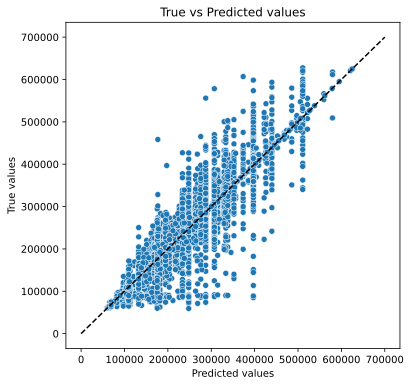

In [131]:
dt_model = DecisionTreeRegressor(criterion='mse', 
                                 max_depth=10,  
                                 min_samples_leaf=1,
                                 random_state=42)
dt_model.fit(X_train, y_train)

y_train_preds = dt_model.predict(X_train)
evaluate_preds(y_train, y_train_preds)

R2:	0.571
RMSE:	62856.097
MSE:	3950888903.379


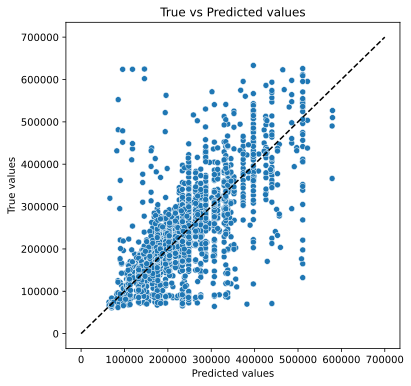

In [132]:
# Проверка точности молдели на тестовых данных из набора train
y_test_preds = dt_model.predict(X_test)
evaluate_preds(y_test, y_test_preds)

Попробуем подобрать гипперпаметры пока без использования поиска по сетке, снизив переобучение на тренировочных данных

R2:	0.689
RMSE:	50901.181
MSE:	2590930233.21


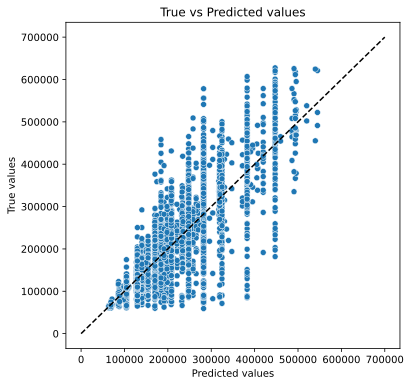

In [133]:
dt_model = DecisionTreeRegressor(criterion='mse', 
                                 max_depth=7,  
                                 min_samples_leaf=2,
                                 random_state=42)
dt_model.fit(X_train, y_train)

y_train_preds = dt_model.predict(X_train)
evaluate_preds(y_train, y_train_preds)

R2:	0.608
RMSE:	60062.41
MSE:	3607493141.422


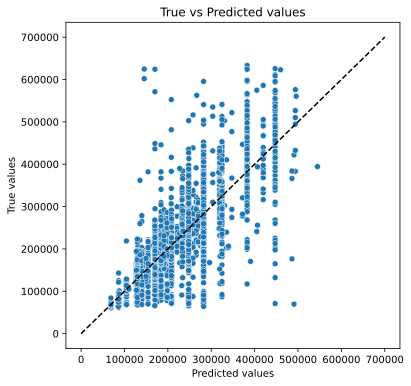

In [134]:
y_test_preds = dt_model.predict(X_test)
evaluate_preds(y_test, y_test_preds)

Получается, что изменненные гипперпараметры, дающие низкую точность предсказания на обучении, дают более точный результат на тестовых данных:
- max_depth = 7
- min_samples_leaf = 2
- R2 = 0.608

А при параметрах ранее:
- max_depth = 10
- min_samples_leaf = 1
- R2 = 0.571

**Регрессионная модель случайного дерева решений (RandomForestRegressor) <a class='anchor' id ='prepeared_RandomForestRegressor'>**

Модель случайного дерева решений относится к моделям бэггинга, т.е. когда ошибка отклонения всех алгоритмов используеемых на  рандомных выборках, усредняется. Эффективность бэггинга достигается благодаря тому, что базовые алгоритмы, обученные по различным подвыборкам, получаются достаточно различными, и их ошибки взаимно компенсируются при голосовании, а также за счёт того, что объекты-выбросы могут не попадать в некоторые обучающие подвыборки.

R2:	0.844
RMSE:	36021.377
MSE:	1297539610.112


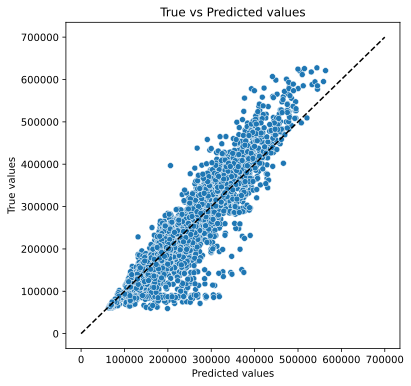

In [135]:
rfreg_model = RandomForestRegressor(criterion ='mse',
                                   max_depth = 10,
                                   min_samples_leaf = 1,
                                   random_state = 42)
rfreg_model.fit(X_train,y_train)
y_train_preds = rfreg_model.predict(X_train)
evaluate_preds(y_train, y_train_preds)

R2:	0.714
RMSE:	51309.481
MSE:	2632662890.27


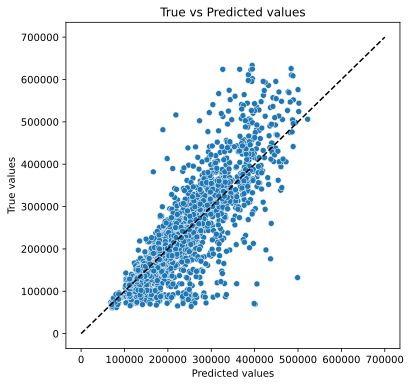

In [136]:
y_test_preds = rfreg_model.predict(X_test)
evaluate_preds(y_test, y_test_preds)

Модель так же немного переобучена, поэтому возьмем те же гипперпараметры,что ив случае с моделью дерева решений:
- max_depth = 7
- min_samples_leaf = 2

R2:	0.739
RMSE:	46633.406
MSE:	2174674593.826


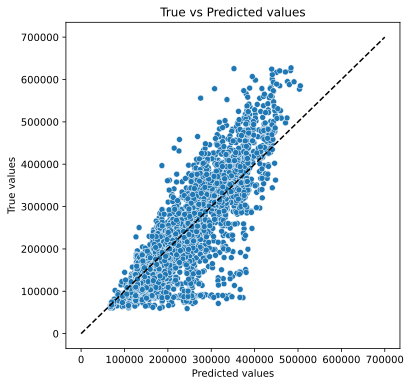

In [137]:
rfreg_model = RandomForestRegressor(criterion ='mse',
                                   max_depth = 7,
                                   min_samples_leaf = 2,
                                   random_state = 42)
rfreg_model.fit(X_train,y_train)
y_train_preds = rfreg_model.predict(X_train)
evaluate_preds(y_train, y_train_preds)

R2:	0.689
RMSE:	53522.522
MSE:	2864660354.667


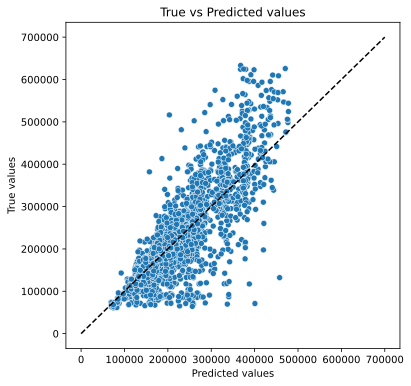

In [138]:
y_test_preds = rfreg_model.predict(X_test)
evaluate_preds(y_test, y_test_preds)

Сравним данные Дерева решений и случайного леса на тестовых данных:
- max_depth = 7
- min_samples_leaf = 2
- R2_DT = 0.608
- R2_RFR = 0.72

А при изначальных параметрах:
- max_depth = 10
- min_samples_leaf = 1
- R2_DT = 0.571
- R2_RFR = 0.689

Необходимо выполнить более осознанный подбор параметров для регрессионной модели случайного леса, как дающей наиболее лучшее предсказание на тестовых данных.

R2:	0.883
RMSE:	31255.938
MSE:	976933668.723


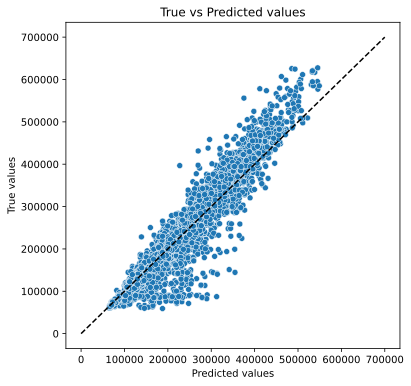

In [139]:
rfreg_model = RandomForestRegressor(criterion ='mse',
                                   max_depth = 12,
                                   min_samples_leaf = 2,
                                   n_estimators = 300,
                                   random_state = 42)
rfreg_model.fit(X_train,y_train)
y_train_preds = rfreg_model.predict(X_train)
evaluate_preds(y_train, y_train_preds)

R2:	0.72
RMSE:	50768.514
MSE:	2577442013.663


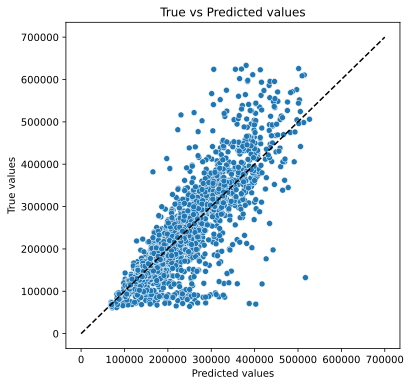

In [140]:
y_test_preds = rfreg_model.predict(X_test)
evaluate_preds(y_test, y_test_preds)

R2:	0.85
RMSE:	35344.353
MSE:	1249223288.705


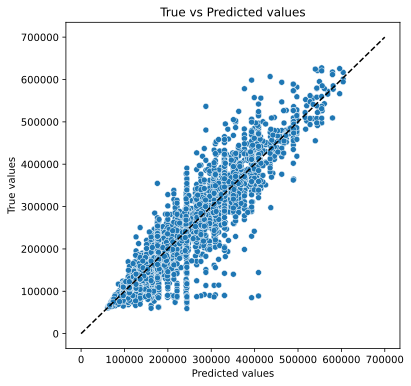

In [141]:
dt_model = DecisionTreeRegressor(criterion='mse', 
                                 max_depth=12,  
                                 min_samples_leaf=2,
                             
                                 random_state=42)
dt_model.fit(X_train, y_train)

y_train_preds = dt_model.predict(X_train)
evaluate_preds(y_train, y_train_preds)

R2:	0.576
RMSE:	62531.241
MSE:	3910156154.655


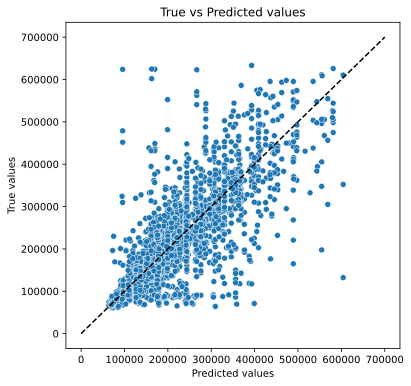

In [142]:
y_test_preds = dt_model.predict(X_test)
evaluate_preds(y_test, y_test_preds)

Сравнение параметров точности моделей на тестовых данных:

При изначальных параметрах:
- max_depth = 10
- min_samples_leaf = 1
    - R2_DT = 0.571
    - R2_RFR = 0.689
    

При параметрах подобранных вручную:
- max_depth = 7
- min_samples_leaf = 2
    - R2_DT = 0.608
    - R2_RFR = 0.72

**Регрессионная модель градиентного бустинга (GradientBoostingRegressor) <a class='anchor' id ='prepeared_GradientBoostingRegressor'>**

R2:	0.991
RMSE:	8493.221
MSE:	72134803.943


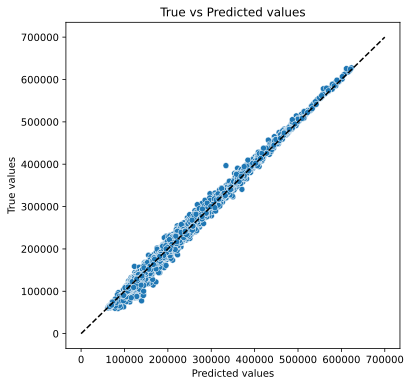

In [143]:
gb_model = GradientBoostingRegressor(criterion ='mse',
                                    max_depth = 10,
                                    min_samples_leaf = 1,
                                    random_state = 42)

gb_model.fit(X_train,y_train)

y_train_preds = gb_model.predict(X_train)
evaluate_preds(y_train,y_train_preds)

R2:	0.709
RMSE:	51814.907
MSE:	2684784592.062


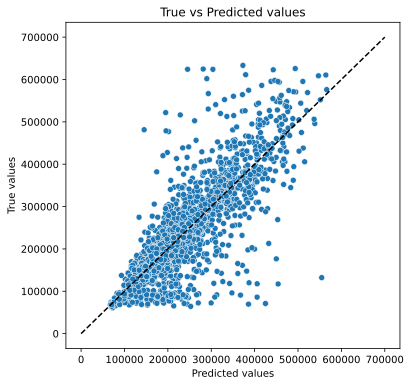

In [144]:
y_test_preds = gb_model.predict(X_test)
evaluate_preds(y_test, y_test_preds)

R2:	0.935
RMSE:	23216.033
MSE:	538984187.685


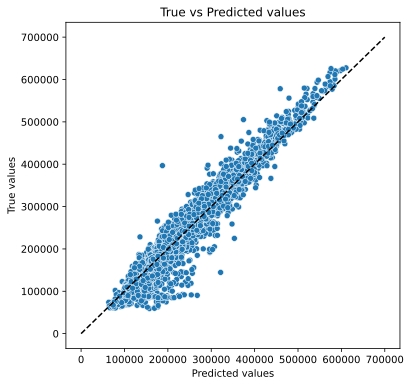

In [145]:
gb_model = GradientBoostingRegressor(criterion ='mse',
                                    max_depth = 7,
                                    min_samples_leaf = 2,
                                    random_state = 42)

gb_model.fit(X_train,y_train)

y_train_preds = gb_model.predict(X_train)
evaluate_preds(y_train,y_train_preds)

R2:	0.727
RMSE:	50126.072
MSE:	2512623109.412


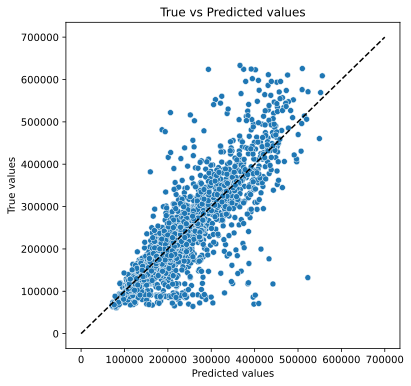

In [146]:
y_test_preds = gb_model.predict(X_test)
evaluate_preds(y_test, y_test_preds)

R2:	0.881
RMSE:	31496.378
MSE:	992021799.137


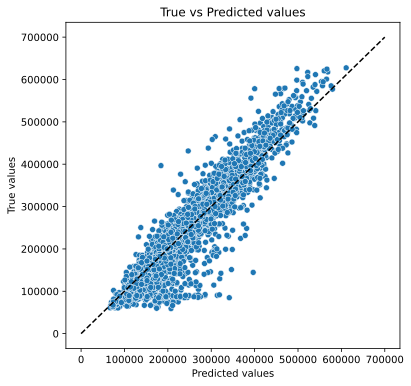

In [147]:
gb_model = GradientBoostingRegressor(criterion ='mse',
                                    max_depth = 6,
                                    min_samples_leaf = 6,
                                    n_estimators = 90,
                                    random_state = 42)

gb_model.fit(X_train,y_train)

y_train_preds = gb_model.predict(X_train)
evaluate_preds(y_train,y_train_preds)

R2:	0.734
RMSE:	49534.581
MSE:	2453674734.35


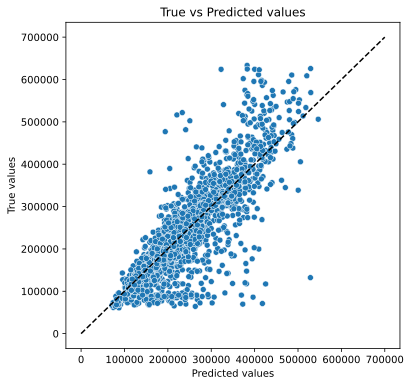

In [148]:
y_test_preds = gb_model.predict(X_test)
evaluate_preds(y_test, y_test_preds)

**Поиск гипперпараметров для выбранной модели GradientBosstingRegressor <a class='anchor' id ='GridSearch_GradientBosstingRegressor'>**

In [149]:
''' 
Для экономии времении загрузки закоментировал GridSearch (4 min 31 s)

%%time
params = {'max_depth': [4,5,6,7,8,15],
          'min_samples_leaf':[2,4,5,6,7,8,10],
          'n_estimators':[50,60,70,80,10,125]}

gs =GridSearchCV(gb_model, params,
                scoring = 'r2',
                cv = KFold(n_splits=5, random_state = 21, shuffle = True),
                n_jobs = -1
                )

gs.fit(X_train,y_train)

'''

" \nДля экономии времении загрузки закоментировал GridSearch (4 min 31 s)\n\n%%time\nparams = {'max_depth': [4,5,6,7,8,15],\n          'min_samples_leaf':[2,4,5,6,7,8,10],\n          'n_estimators':[50,60,70,80,10,125]}\n\ngs =GridSearchCV(gb_model, params,\n                scoring = 'r2',\n                cv = KFold(n_splits=5, random_state = 21, shuffle = True),\n                n_jobs = -1\n                )\n\ngs.fit(X_train,y_train)\n\n"

In [150]:
# gs.best_params_

best_params показали следующие данные: {'max_depth': 6, 'min_samples_leaf': 5, 'n_estimators': 125}

R2:	0.904
RMSE:	28314.684
MSE:	801721325.721


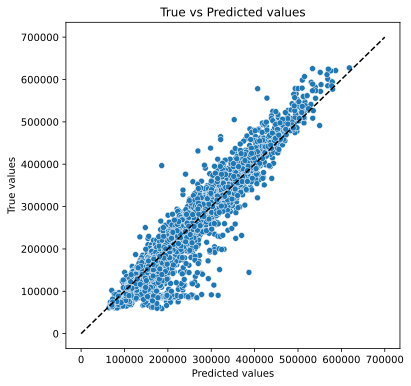

In [151]:
gb_model = GradientBoostingRegressor(criterion ='mse',
                                    max_depth = 6,
                                    min_samples_leaf = 5,
                                    n_estimators = 125,
                                    random_state = 42)

gb_model.fit(X_train,y_train)

y_train_preds = gb_model.predict(X_train)
evaluate_preds(y_train,y_train_preds)

R2:	0.736
RMSE:	49285.293
MSE:	2429040138.492


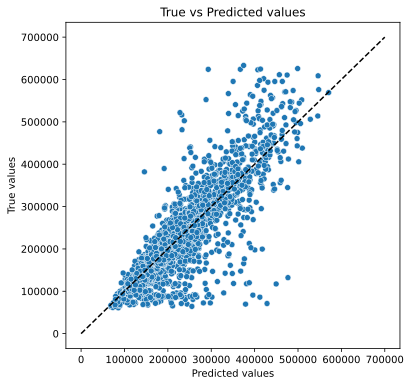

In [152]:
y_test_preds = gb_model.predict(X_test)
evaluate_preds(y_test, y_test_preds)

**Сложная модель  стекинга  StackingRegressor**<a class ='anchor' id = 'stacking'>

R2:	0.832
RMSE:	37373.987
MSE:	1396814934.593


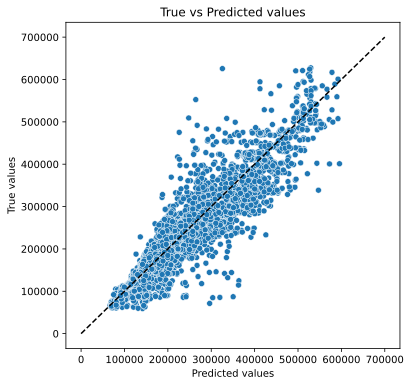

In [153]:
from sklearn.ensemble import StackingRegressor,BaggingRegressor

alp = 0.03
lasso_model = Lasso(alpha = alp)

knr_model = KNeighborsRegressor(n_neighbors = 6,
                         weights = 'distance',
                         leaf_size = 30,
                         n_jobs = -1)

gb_model = GradientBoostingRegressor(criterion ='mse',
                                    max_depth = 6,
                                    min_samples_leaf = 5,
                                    n_estimators = 125,
                                    random_state = 42)

estimators = [('L1', lasso_model), ('knn',knr_model)]

stk = StackingRegressor(estimators=estimators,
                        final_estimator = gb_model,
                        n_jobs = -1)

stk.fit(X_train, y_train)
y_train_preds = stk.predict(X_train) 

evaluate_preds(y_train, y_train_preds)

R2:	0.791
RMSE:	43863.086
MSE:	1923970330.402


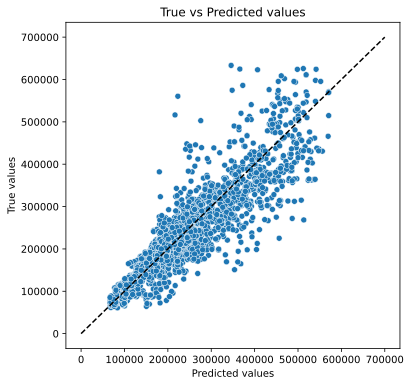

In [154]:
stk.fit(X_test, y_test)
y_test_preds = stk.predict(X_test) 

evaluate_preds(y_test, y_test_preds)

Отличный от простого градиентного бустинга показала модель стекинга линейой модели, KNN и бустинга, как финальной. Попробуем добавить в estimators модель беггинга случайного лесса и сравнить результаты.

R2:	0.884
RMSE:	31134.622
MSE:	969364706.354


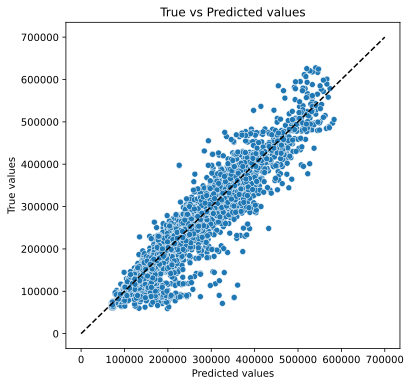

In [155]:
from sklearn.ensemble import BaggingRegressor

alp = 0.03
lasso_model = Lasso(alpha = alp)

knr_model = KNeighborsRegressor(n_neighbors = 6,
                         weights = 'distance',
                         leaf_size = 30,
                         n_jobs = -1)

gb_model = GradientBoostingRegressor(criterion ='mse',
                                    max_depth = 6,
                                    min_samples_leaf = 5,
                                    n_estimators = 125,
                                    random_state = 42)

rfreg_model = RandomForestRegressor(criterion ='mse',
                                   max_depth = 12,
                                   min_samples_leaf = 2,
                                   random_state = 42)


bg = BaggingRegressor(rfreg_model, base_estimator=125, n_jobs = -1)


estimators = [('L1', lasso_model), ('knn',knr_model), ('RF_bagging',bg)]

stk = StackingRegressor(estimators=estimators,
                        final_estimator = gb_model,
                        n_jobs = -1)

stk.fit(X_train, y_train)
y_train_preds = stk.predict(X_train) 

evaluate_preds(y_train, y_train_preds)

R2:	0.853
RMSE:	36738.341
MSE:	1349705672.053


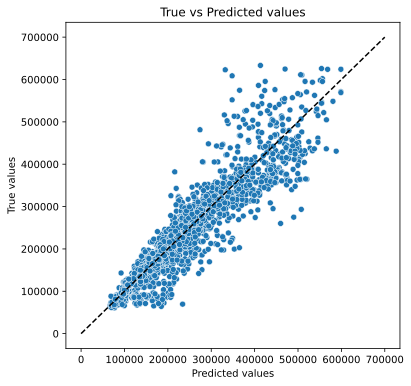

In [156]:
stk.fit(X_test, y_test)
y_test_preds = stk.predict(X_test) 

evaluate_preds(y_test, y_test_preds)

Сохраним финальную модель в файл под названием final_model.pkl

In [157]:
final_model = stk
with open(MODEL_FILE_PATH,'wb') as file:
    pickle.dump(final_model, file)

## Предсказание целевой переменной Price на выбранной модели (test.csv)<a class ='anchor' id = 'final_model'>

In [158]:
df = pd.read_csv(TEST_DATASET_PATH, sep =',')
df = reduce_mem_usage(df)

Memory usage of dataframe is 0.72 MB
Memory usage after optimization is: 0.21 MB
Decreased by 70.3%


In [159]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5000 entries, 0 to 4999
Data columns (total 19 columns):
 #   Column         Non-Null Count  Dtype   
---  ------         --------------  -----   
 0   Id             5000 non-null   int16   
 1   DistrictId     5000 non-null   int16   
 2   Rooms          5000 non-null   float32 
 3   Square         5000 non-null   float32 
 4   LifeSquare     3959 non-null   float32 
 5   KitchenSquare  5000 non-null   float32 
 6   Floor          5000 non-null   int8    
 7   HouseFloor     5000 non-null   float32 
 8   HouseYear      5000 non-null   int16   
 9   Ecology_1      5000 non-null   float32 
 10  Ecology_2      5000 non-null   category
 11  Ecology_3      5000 non-null   category
 12  Social_1       5000 non-null   int8    
 13  Social_2       5000 non-null   int16   
 14  Social_3       5000 non-null   int16   
 15  Healthcare_1   2623 non-null   float32 
 16  Helthcare_2    5000 non-null   int8    
 17  Shops_1        5000 non-null   in

**Обработка данных**

In [160]:
pipe = DataPipeline()
pipe.fit(df)
df = pipe.transform(df)

**Проверка выбранной модели**

1. Модель: StackingRegressor
2. Параметры (estimators):
    - **Lasso**(alpha = 0.03)
    - **KNeighborsRegressor**(n_neighbors = 6, weights = 'distance',leaf_size = 30,n_jobs=-1)
    - **BaggingRegressor** (
        - **RandomForestRegressor**(criterion ='mse', max_depth = 12, min_samples_leaf = 2, random_state = 42),
        - **base_estimator**=125)

3. Точность предсказания на тренировочном датасете R2 = 0.861
4. Бизнес точность предсказания цены RMSE = 35828.452


In [161]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5000 entries, 0 to 4999
Data columns (total 22 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   DistrictId        5000 non-null   int16  
 1   Rooms             5000 non-null   int8   
 2   Square            5000 non-null   float32
 3   LifeSquare        5000 non-null   float32
 4   KitchenSquare     5000 non-null   float32
 5   Floor             5000 non-null   int8   
 6   HouseFloor        5000 non-null   int32  
 7   HouseYear         5000 non-null   float64
 8   Ecology_1         5000 non-null   float32
 9   Social_1          5000 non-null   int8   
 10  Social_2          5000 non-null   int16  
 11  Social_3          5000 non-null   int16  
 12  Healthcare_1      5000 non-null   float32
 13  Helthcare_2       5000 non-null   int8   
 14  Shops_1           5000 non-null   int8   
 15  Eco2_A            5000 non-null   uint8  
 16  Eco2_B            5000 non-null   uint8  


In [162]:
submit = pd.read_csv('./sample_submission.csv')
submit.head()

,Id,Price
0,4567,200000.0
1,5925,200000.0
2,960,200000.0
3,3848,200000.0
4,746,200000.0


In [163]:
predictions = stk.predict(df)
predictions

array([411699.5877011 , 337942.53531381, 323827.65731229, ...,
       485477.31252594, 434759.98882201, 417340.55628255])

In [164]:
submit['Price'] = predictions
submit.head()

,Id,Price
0,4567,411699.587701
1,5925,337942.535314
2,960,323827.657312
3,3848,312807.013156
4,746,368274.515214


In [165]:
submit.to_csv('stk_submit.csv',sep =',', index=False)

In [166]:
submit.shape


(5000, 2)

In [167]:
df.shape

(5000, 22)

In [168]:
X_train.shape

(6700, 22)

In [170]:
yy=y_train.iloc[:5000]

In [171]:
yy.shape

(5000,)

In [172]:
predictions.shape

(5000,)

R2:	-4.399
RMSE:	210548.497
MSE:	44330669677.604


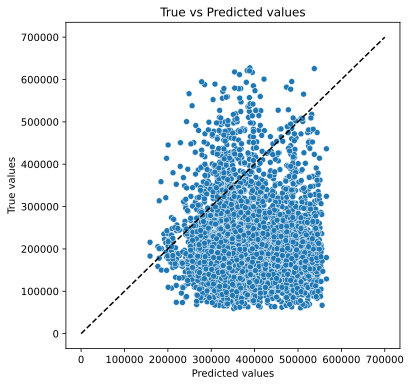

In [173]:
evaluate_preds(yy, predictions)

In [175]:
gb_model = GradientBoostingRegressor(criterion ='mse',
                                    max_depth = 6,
                                    min_samples_leaf = 5,
                                    n_estimators = 125,
                                    random_state = 42)

gb_model.fit(X_train,y_train)

yyy = gb_model.predict(df)

R2:	-4.114
RMSE:	204912.92
MSE:	41989304963.933


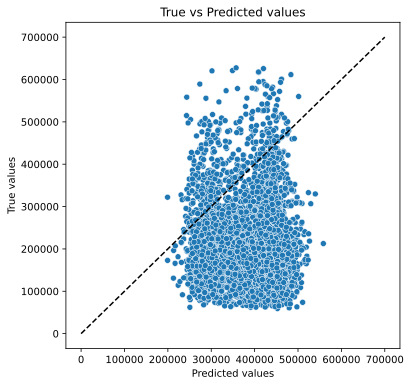

Получается что нга тестовых данных, любая модель показывает отрицательный результат...
Что очень странно. Возможно дело впредобработке исходных данных..
Оставим только в DataPiple заполнение пустых данных медианными значениями,а нулевых площадей,так же медианными значеняими и сраним результат,выбросив признак ID

In [185]:
class DataPipeline2:
    """Подготовка исходных данных"""
    
    def __init__(self):
        """Параметры класса"""
        self.medians = None
                
    def fit(self, df):
        """Сохранение статистик"""
        
        # Расчет медиан
        self.medians = df[['LifeSquare', 'Healthcare_1']].median()
        self.KitchenSquare_median = df['KitchenSquare'].median()
        self.LifeSquare_median =  df['LifeSquare'].median()
        self.Rooms_median =  df['Rooms'].median()
        self.Square_median =  df['Square'].median()
        self.HouseYear_median =  df['HouseYear'].median()             
        
                
    def transform(self, df):
        """Трансформация данных"""
        
        # 1. Пропуски заполняем медианами
        df[['LifeSquare', 'Healthcare_1']] = df[['LifeSquare', 'Healthcare_1']].fillna(self.medians)
        
        
        # 2. Выбросы (outliers)
        
        df.loc[df['KitchenSquare'] == 0, 'KitchenSquare'] = self.KitchenSquare_median
        df.loc[df['LifeSquare'] < 1, 'LifeSquare'] = self.LifeSquare_median
       
        df.loc[df['Square'] ==0, 'Square'] = self.Square_median
        df.loc[df['Rooms'] == 0, 'Rooms'] = self.Rooms_median
        df.loc[df['HouseYear'] >2021, 'HouseYear'] = self.HouseYear_median
        
        # 3. Обработка категорий
        df = pd.concat([df, pd.get_dummies(df['Ecology_2'],prefix = 'Eco2')], axis = 1) 
        df = pd.concat([df, pd.get_dummies(df['Ecology_3'],prefix = 'Eco3')], axis = 1)
        df = pd.concat([df, pd.get_dummies(df['Shops_2'],prefix = 'Shops2')], axis = 1) 
        
        df = df.drop(['Ecology_2','Ecology_3','Shops_2'], axis = 1) 
                
        
        # 4. Новые фичи (features)
        
        # Доля жилой площади в общей площади квартиры (LifeSquare_index)
        df['LifeSquare_index'] = df['Square']/df['LifeSquare']
        
        # 5. Преобразование типов данных
        
        df['HouseFloor'] = df['HouseFloor'].astype('int32')
        df['Rooms'] = df['Rooms'].astype('int8')
        
        # 6. Отброс не нужного параметра ID
        df = df.drop('Id', axis =1)

In [187]:
df2 = pd.read_csv(TEST_DATASET_PATH, sep =',')
df2 = reduce_mem_usage(df2)

Memory usage of dataframe is 0.72 MB
Memory usage after optimization is: 0.21 MB
Decreased by 70.3%


In [188]:
pipe2 = DataPipeline2()
pipe2.fit(df2)
df2 = pipe.transform(df2)

In [189]:
gb_model = GradientBoostingRegressor(criterion ='mse',
                                    max_depth = 6,
                                    min_samples_leaf = 5,
                                    n_estimators = 125,
                                    random_state = 42)

gb_model.fit(X_train,y_train)

y_preds_gb = gb_model.predict(df2)

R2:	-8.069
RMSE:	204912.92
MSE:	41989304963.933


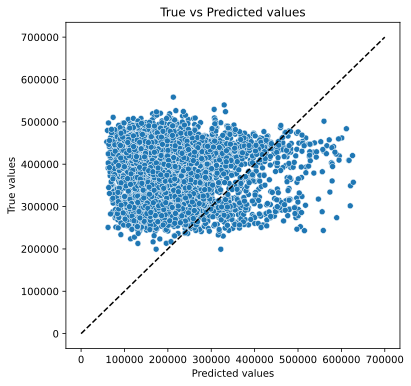

In [191]:
y5000=y_train.iloc[:5000]
evaluate_preds(y5000, y_preds_gb)